# Clustering

RE: Clustering post anomaly detection

In [11]:
import os
import pandas as pd
import matplotlib.pyplot as plt
from libraries.clustering import apply_pca, plot_results, apply_tsne
from libraries import clustering
from sklearn.cluster import KMeans, OPTICS, DBSCAN
from scipy.spatial.distance import squareform
from sklearn.cluster import DBSCAN
import numpy as np
from sklearn.cluster import SpectralClustering
from pyclustering.cluster.optics import optics, ordering_analyser
from libraries.clustering import sil_vs_coh
from sklearn.metrics import pairwise_distances

In [12]:
DATASET_DIR = "dataset" + os.sep
RESULTS_DIR = "results" + os.sep

In [13]:
merged_df = pd.read_csv(DATASET_DIR + "merge_clean_v2-AD.csv", parse_dates=["date"])
cyclist_df = pd.read_csv(DATASET_DIR + "cyclist_clean_v3.csv")
stages_df = pd.read_csv(DATASET_DIR + "stages_clean_v3.csv")

In [14]:
cyclist_df.info()
stages_df.info()
merged_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3020 entries, 0 to 3019
Data columns (total 6 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Unnamed: 0  3020 non-null   int64  
 1   _url        3020 non-null   object 
 2   birth_year  3020 non-null   int64  
 3   height      3020 non-null   float64
 4   avg_pos     3020 non-null   float64
 5   num_races   3020 non-null   int64  
dtypes: float64(2), int64(3), object(1)
memory usage: 141.7+ KB
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2895 entries, 0 to 2894
Data columns (total 12 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Unnamed: 0         2895 non-null   int64  
 1   _url               2895 non-null   object 
 2   points             2895 non-null   int64  
 3   length             2895 non-null   int64  
 4   climb_total        2895 non-null   int64  
 5   profile            2895 non-null   int64  
 6   startl

In [15]:
#cyclist_df.drop(columns=["name", "nationality", 'continent', "BMI"], inplace=True)
#stages_df.drop(columns=["stage", "date", "race"], inplace=True)

#cyclist_df.reset_index(drop=True, inplace=True)
#stages_df.reset_index(drop=True, inplace=True)

In [16]:
cyclist_df = cyclist_df.dropna()
stages_df = stages_df.dropna()

In [17]:
cyclist_df.info()
stages_df.info()
merged_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3020 entries, 0 to 3019
Data columns (total 6 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Unnamed: 0  3020 non-null   int64  
 1   _url        3020 non-null   object 
 2   birth_year  3020 non-null   int64  
 3   height      3020 non-null   float64
 4   avg_pos     3020 non-null   float64
 5   num_races   3020 non-null   int64  
dtypes: float64(2), int64(3), object(1)
memory usage: 141.7+ KB
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2895 entries, 0 to 2894
Data columns (total 12 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Unnamed: 0         2895 non-null   int64  
 1   _url               2895 non-null   object 
 2   points             2895 non-null   int64  
 3   length             2895 non-null   int64  
 4   climb_total        2895 non-null   int64  
 5   profile            2895 non-null   int64  
 6   startl

In [18]:
# transformation
cat_cyclist = []
stand_cyclist = ["height", "birth_year", 'avg_pos', 'num_races']
minmax_cyclist = []
transformed_cyclists_data, preprocessor_cyclists = clustering.transform(
    cyclist_df,
    categorical_cols=cat_cyclist,
    standardize_cols=stand_cyclist,
    minmax_cols=minmax_cyclist,
)

cat_stage = []
stand_stage = ["year", "length", "startlist_quality", 'avg_age_by_url', 'avg_delta_by_url', 'min_age_by_url', 'points']
minmax_stage = []
transformed_stages_data, preprocessor_stages = clustering.transform(
    stages_df,
    categorical_cols=cat_stage,
    minmax_cols=minmax_stage,
    standardize_cols=stand_stage
)

# obtain df from the transformed data
transformed_cyclists_df = pd.DataFrame(transformed_cyclists_data)
transformed_stages_df = pd.DataFrame(transformed_stages_data)

# Add back the one-hot encoded columns
transformed_cyclists_df.columns = preprocessor_cyclists.get_feature_names_out(
    cyclist_df.columns
)
transformed_stages_df.columns = preprocessor_stages.get_feature_names_out(
    stages_df.columns
)

transformed_cyclists_df.reset_index(drop=True, inplace=True)
transformed_stages_df.reset_index(drop=True, inplace=True)

transformed_cyclists_df["_url"] = cyclist_df["_url"]
transformed_stages_df["_url"] = stages_df["_url"]

In [19]:
transformed_cyclists_df.info()
transformed_stages_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3020 entries, 0 to 3019
Data columns (total 5 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   standardize__height      3020 non-null   float64
 1   standardize__birth_year  3020 non-null   float64
 2   standardize__avg_pos     3020 non-null   float64
 3   standardize__num_races   3020 non-null   float64
 4   _url                     3020 non-null   object 
dtypes: float64(4), object(1)
memory usage: 118.1+ KB
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2895 entries, 0 to 2894
Data columns (total 8 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   standardize__year               2895 non-null   float64
 1   standardize__length             2895 non-null   float64
 2   standardize__startlist_quality  2895 non-null   float64
 3   standardize__avg_age_by_url     2895 non-null 

In [20]:
transformed_cyclists_df.drop(columns=["_url"], inplace=True)
transformed_stages_df.drop(columns=["_url"], inplace=True)

Create a version of the dataframes without categorical columns

In [21]:
def filter_one_hot_columns(df):
    return df.loc[:, ~df.columns.str.startswith("cat__")]


real_cyclists_df = filter_one_hot_columns(transformed_cyclists_df)
real_stages_df = filter_one_hot_columns(transformed_stages_df)

real_cyclists_df.info()
real_stages_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3020 entries, 0 to 3019
Data columns (total 4 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   standardize__height      3020 non-null   float64
 1   standardize__birth_year  3020 non-null   float64
 2   standardize__avg_pos     3020 non-null   float64
 3   standardize__num_races   3020 non-null   float64
dtypes: float64(4)
memory usage: 94.5 KB
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2895 entries, 0 to 2894
Data columns (total 7 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   standardize__year               2895 non-null   float64
 1   standardize__length             2895 non-null   float64
 2   standardize__startlist_quality  2895 non-null   float64
 3   standardize__avg_age_by_url     2895 non-null   float64
 4   standardize__avg_delta_by_url   2895 non-null   floa

In [22]:
cyclists = clustering.inverse_transform(transformed_cyclists_data, preprocessor_cyclists,
                                                      minmax_cols=minmax_cyclist,
                                                      standardize_cols=stand_cyclist,
                                                      categorical_cols=cat_cyclist)
stages = clustering.inverse_transform(transformed_stages_data, preprocessor_stages,
                                                      standardize_cols=stand_stage,
                                                      minmax_cols=minmax_stage,
                                                      categorical_cols=cat_stage)

## K-means

### K-Means cyclists

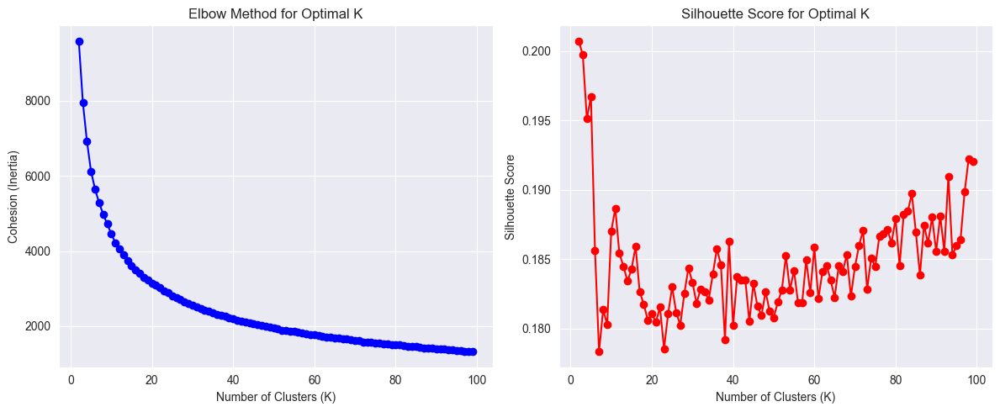

In [23]:
kmeans_list = clustering.plot_scores(real_cyclists_df)

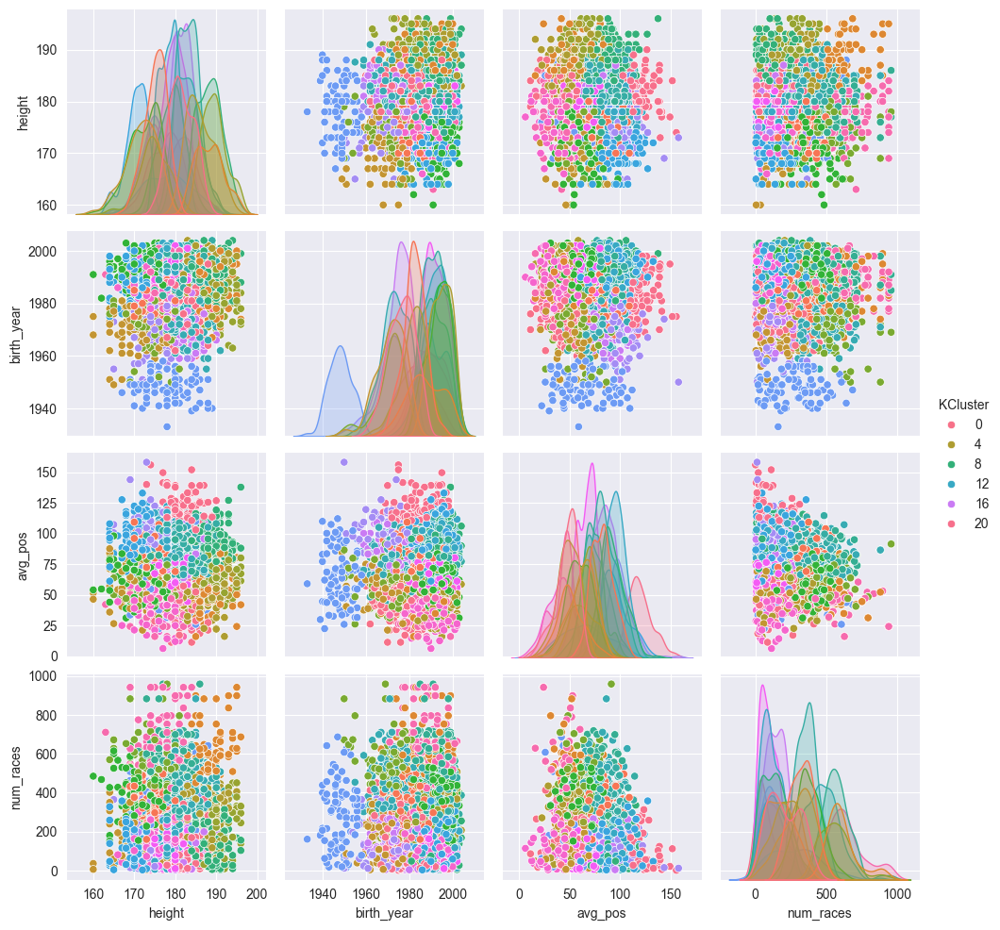

In [24]:
kmeans = kmeans_list[19]
# clustering.optimal_pair_plot(cyclists, 'KCluster', kmeans.labels_, np.array(centers))
clustering.optimal_pair_plot(cyclists, 'KCluster', kmeans.labels_)

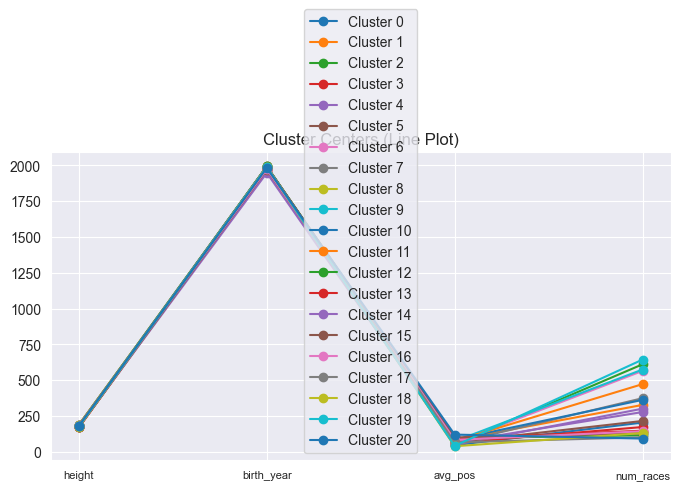

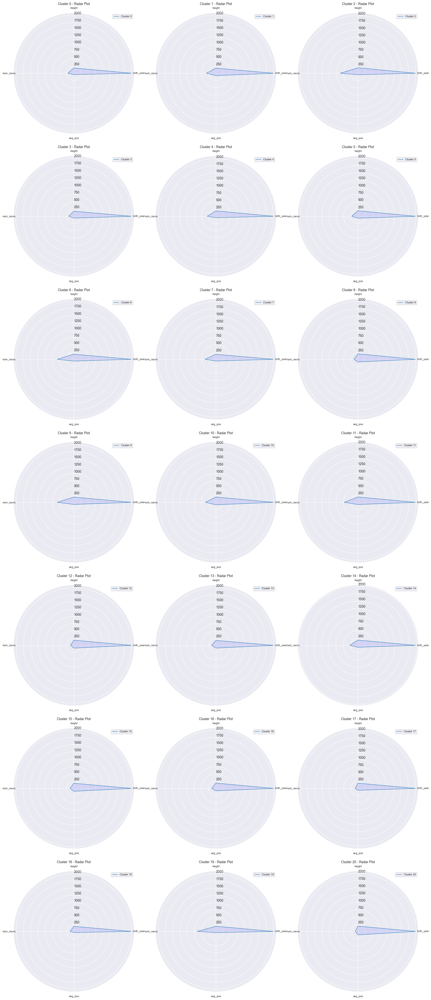

        height   birth_year     avg_pos   num_races
0   181.447853  1976.355828   46.577509  204.484663
1   175.200000  1982.333333   82.539553  327.709091
2   188.288660  1987.226804   51.075276  611.298969
3   171.644928  1971.340580   62.493200  173.384058
4   186.153947  1994.546053   48.769206  301.500000
5   189.409091  1982.053030   66.075827  215.757576
6   174.835052  1970.958763   61.960443  565.298969
7   172.426316  1993.565789   60.113870  374.625000
8   188.433735  1992.981928   92.820701  140.000000
9   179.124832  1991.228188   73.673339  574.845638
10  183.257143  1992.233333   85.690561  363.009524
11  182.801190  1973.172619   75.349072  472.869048
12  178.648649  1992.670270   96.298696  115.394595
13  170.411290  1990.879032   94.279543  147.491935
14  178.045455  1948.147727   65.767722  278.022727
15  174.754545  1970.863636  100.419612  129.463636
16  181.960199  1975.114428   83.316811  143.761194
17  179.695431  1991.598985   66.153649  101.208122
18  175.2517

In [25]:
centers = clustering.inverse_transform(kmeans.cluster_centers_, preprocessor_cyclists,
                                                      minmax_cols=minmax_cyclist,
                                                      standardize_cols=stand_cyclist,
                                                      categorical_cols=cat_cyclist)
clustering.plot_centers(cyclists, centers, 7, 3)
print(centers)

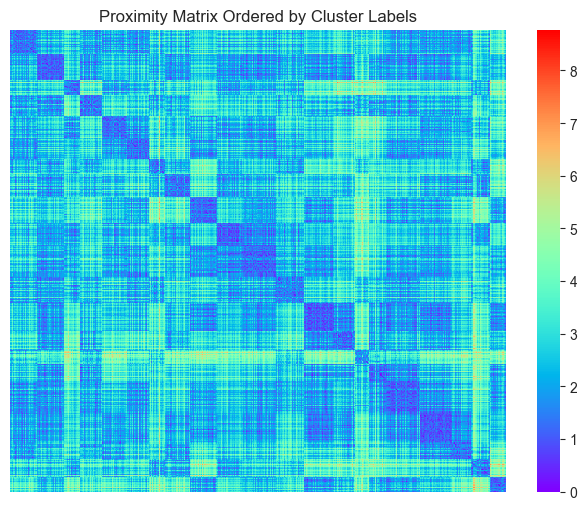

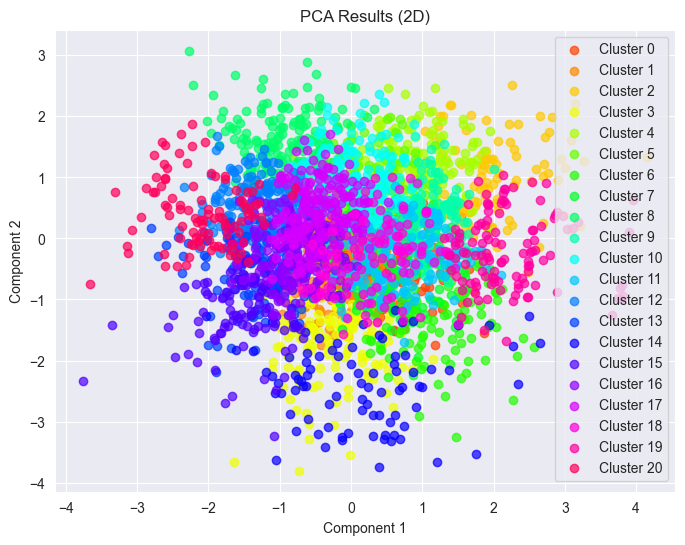

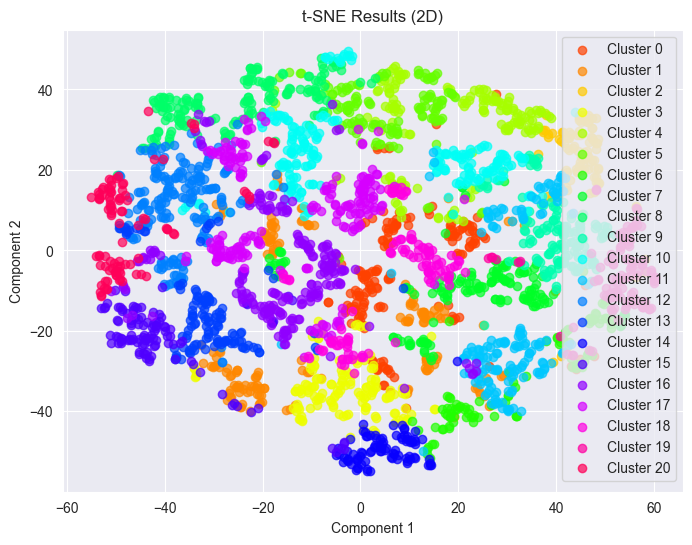

In [26]:
data_scaled = real_cyclists_df
labels = kmeans.labels_

clustering.similarity_matrix(real_cyclists_df, labels)

# 2D PCA
pca_2d = apply_pca(data_scaled, dimensions=2)
plot_results(pca_2d, labels, title="PCA Results (2D)", dimensions=2)

# 2D t-SNE
tsne_2d = apply_tsne(data_scaled, dimensions=2)
plot_results(tsne_2d, labels, title="t-SNE Results (2D)", dimensions=2)

### K-Means stages

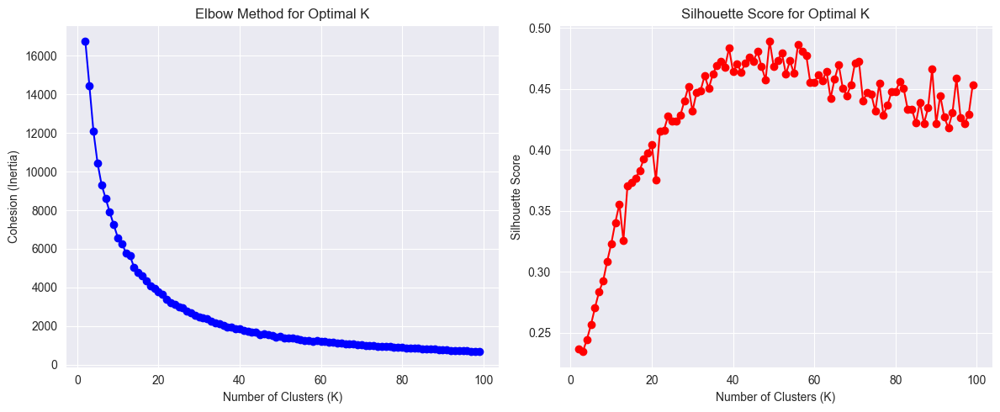

In [27]:
kmeans_list = clustering.plot_scores(real_stages_df)

Plots for optimal K

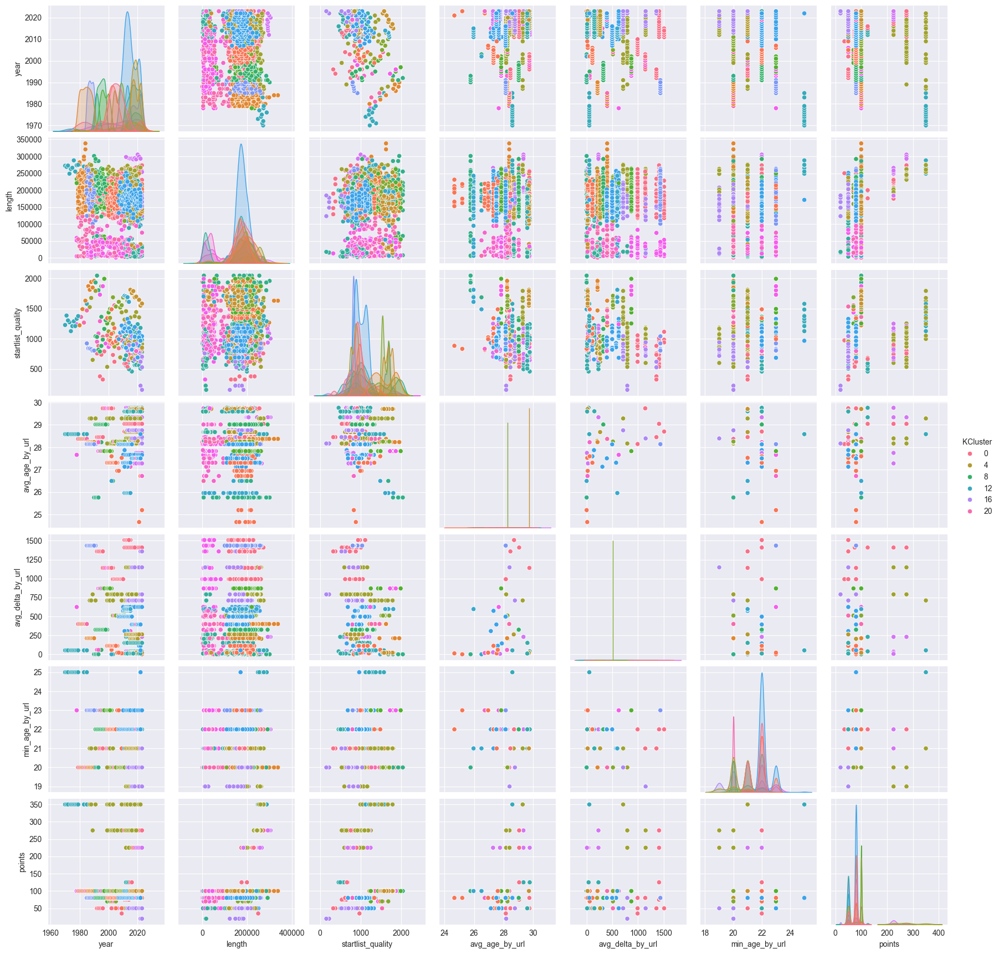

In [28]:
kmeans = kmeans_list[20]
clustering.optimal_pair_plot(stages, 'KCluster', kmeans.labels_)

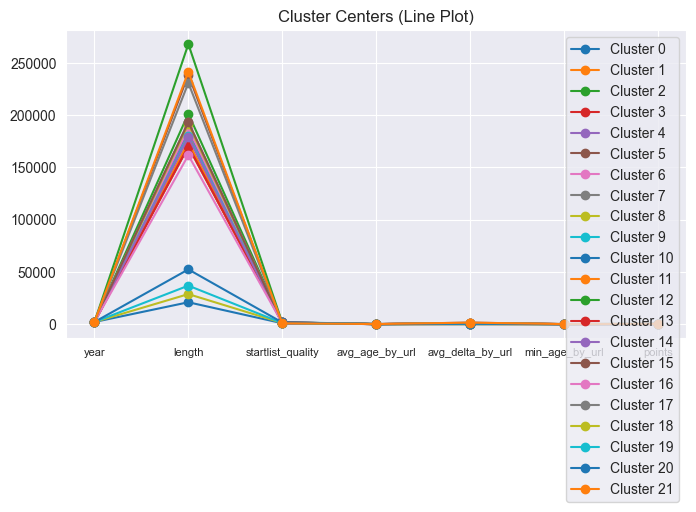

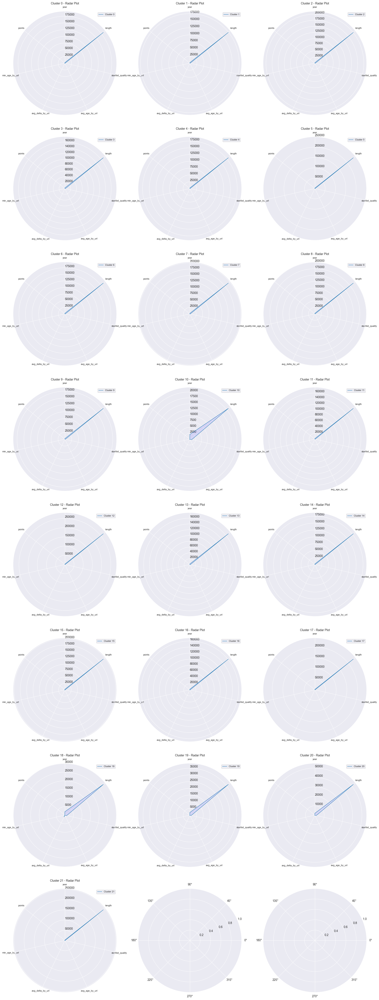

           year         length  startlist_quality  avg_age_by_url  \
0   2005.044534  183989.068826         869.510121       28.614251   
1   2005.475676  174537.297297        1053.632432       27.085223   
2   1984.260638  201437.234043        1588.143617       28.315729   
3   2019.059603  169862.251656        1685.874172       29.708571   
4   2017.783069  182104.232804         851.206349       28.472145   
5   2011.841270  238825.396825        1076.666667       28.536147   
6   2007.036765  187547.794118        1601.860294       28.256579   
7   1997.069767  193302.325581        1660.775194       27.827486   
8   1994.760274  191600.684932        1014.732877       29.012231   
9   1992.450000  180210.000000        1912.550000       25.811111   
10  2018.056338   20926.056338         839.352113       29.012648   
11  2017.481865  171236.269430         929.435233       29.645456   
12  1976.083333  268117.500000        1317.583333       28.588235   
13  2012.376623  170444.155844    

In [29]:
centers = clustering.inverse_transform(kmeans.cluster_centers_, preprocessor_stages,
                                                      standardize_cols=stand_stage,
                                                      minmax_cols=minmax_stage,
                                                      categorical_cols=cat_stage)
clustering.plot_centers(stages, centers, 8, 3)
print(centers)

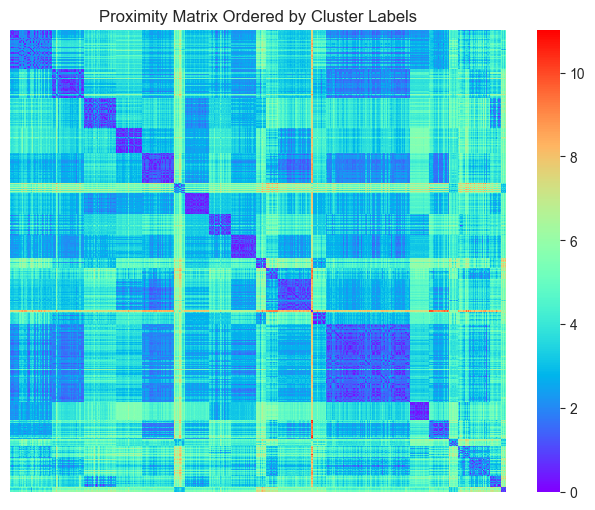

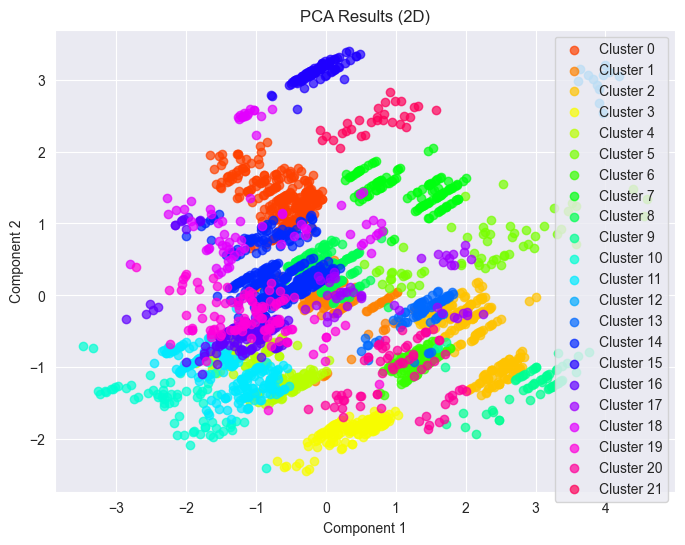

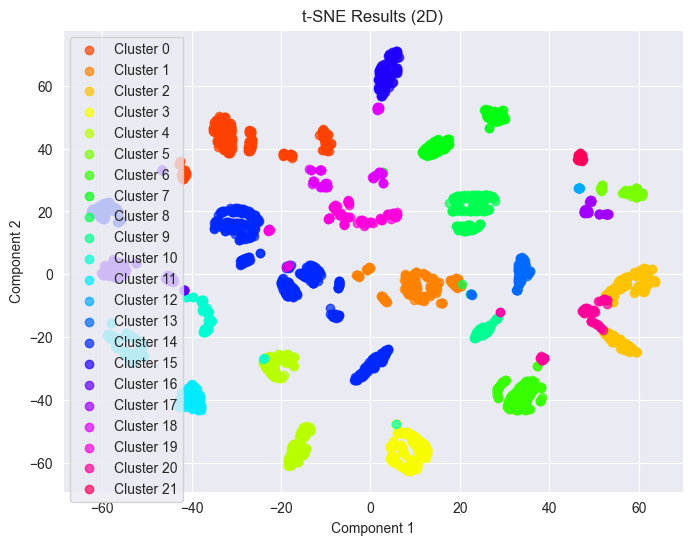

In [30]:
data_scaled = real_stages_df
labels = kmeans.labels_

clustering.similarity_matrix(real_stages_df, labels)

# 2D PCA
pca_2d = apply_pca(data_scaled, dimensions=2)
plot_results(pca_2d, labels, title="PCA Results (2D)", dimensions=2)

# 2D t-SNE
tsne_2d = apply_tsne(data_scaled, dimensions=2)
plot_results(tsne_2d, labels, title="t-SNE Results (2D)", dimensions=2)

### X-means cyclists

Done
Silouette: 0.19991103327485496


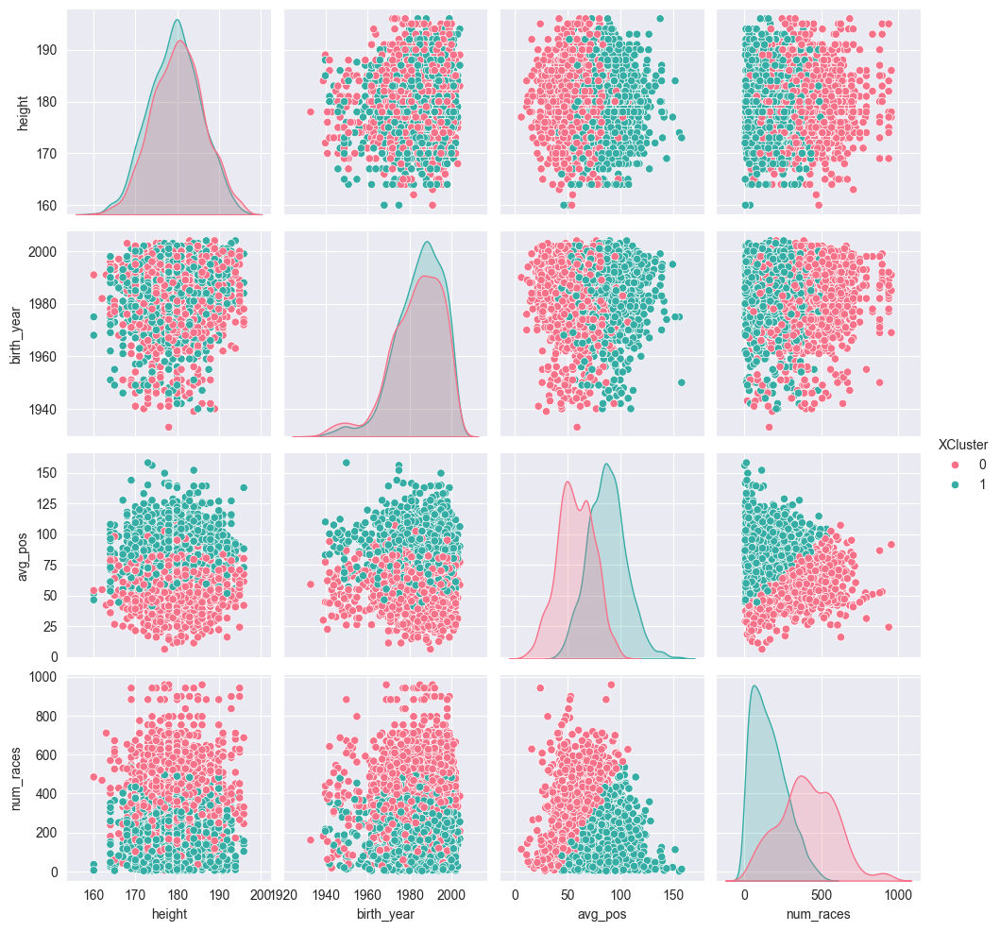

In [31]:
from sklearn.metrics import silhouette_score

labels, centroid = clustering.x_means(real_cyclists_df)

print(f"Silouette: {silhouette_score(real_cyclists_df, labels)}")

clustering.optimal_pair_plot(cyclists, 'XCluster', labels)

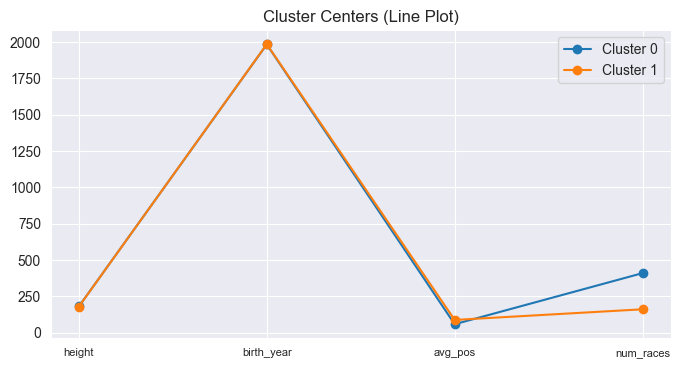

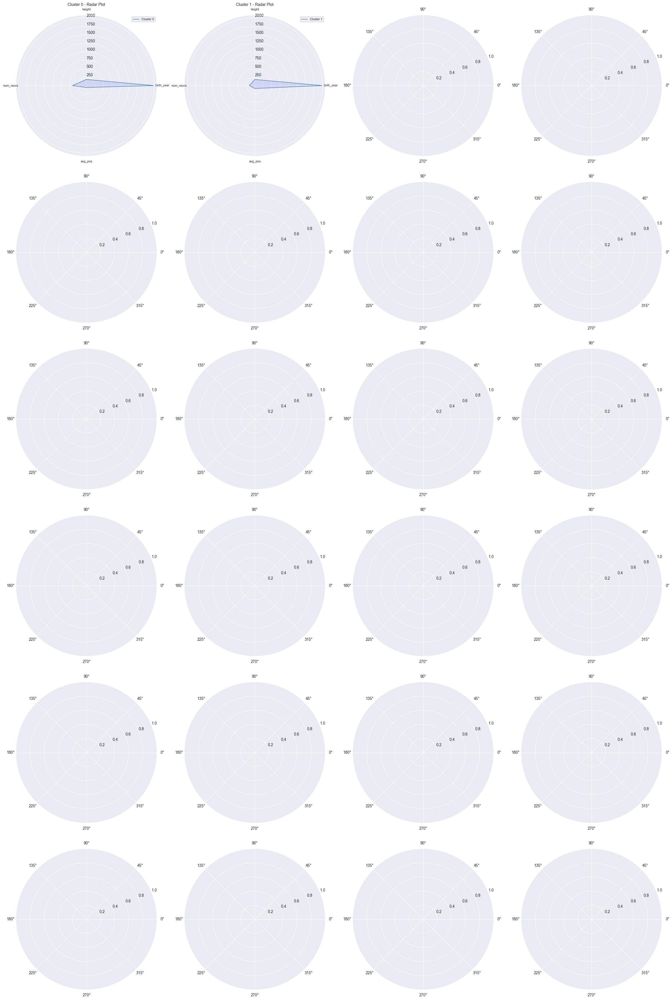

       height   birth_year    avg_pos   num_races
0  180.249417  1983.175704  57.620063  409.223747
1  179.461676  1984.607806  87.220440  160.420345


In [32]:
centers = clustering.inverse_transform(np.array(centroid), preprocessor_cyclists,
                                                      minmax_cols=minmax_cyclist,
                                                      standardize_cols=stand_cyclist,
                                                      categorical_cols=cat_cyclist)
clustering.plot_centers(cyclists, centers, 6, 4)
print(centers)

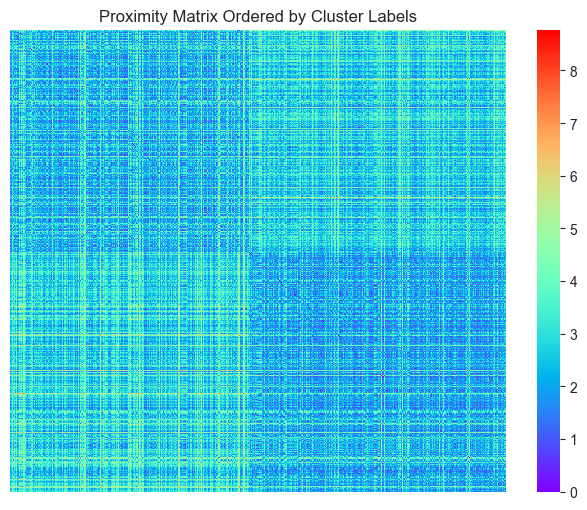

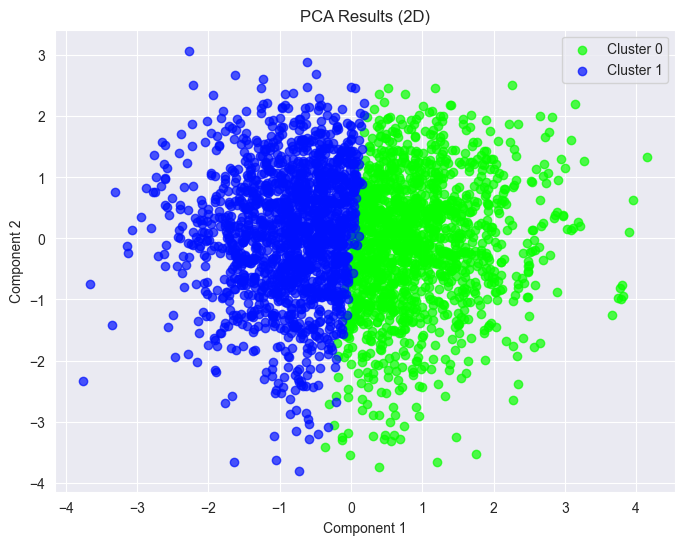

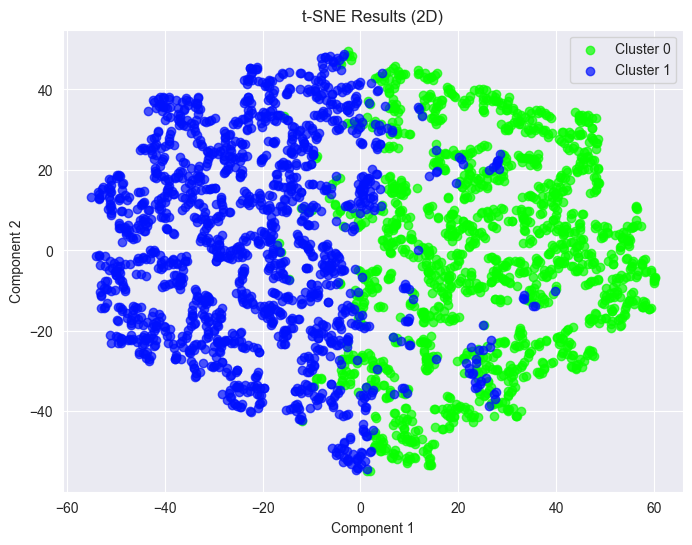

In [33]:
data_scaled = real_cyclists_df

clustering.similarity_matrix(real_cyclists_df, labels)
# 2D PCA
pca_2d = apply_pca(data_scaled, dimensions=2)
plot_results(pca_2d, labels, title="PCA Results (2D)", dimensions=2)

# 2D t-SNE
tsne_2d = apply_tsne(data_scaled, dimensions=2)
plot_results(tsne_2d, labels, title="t-SNE Results (2D)", dimensions=2)

### X-means stages

Done
Silouette: 0.3925354095770857


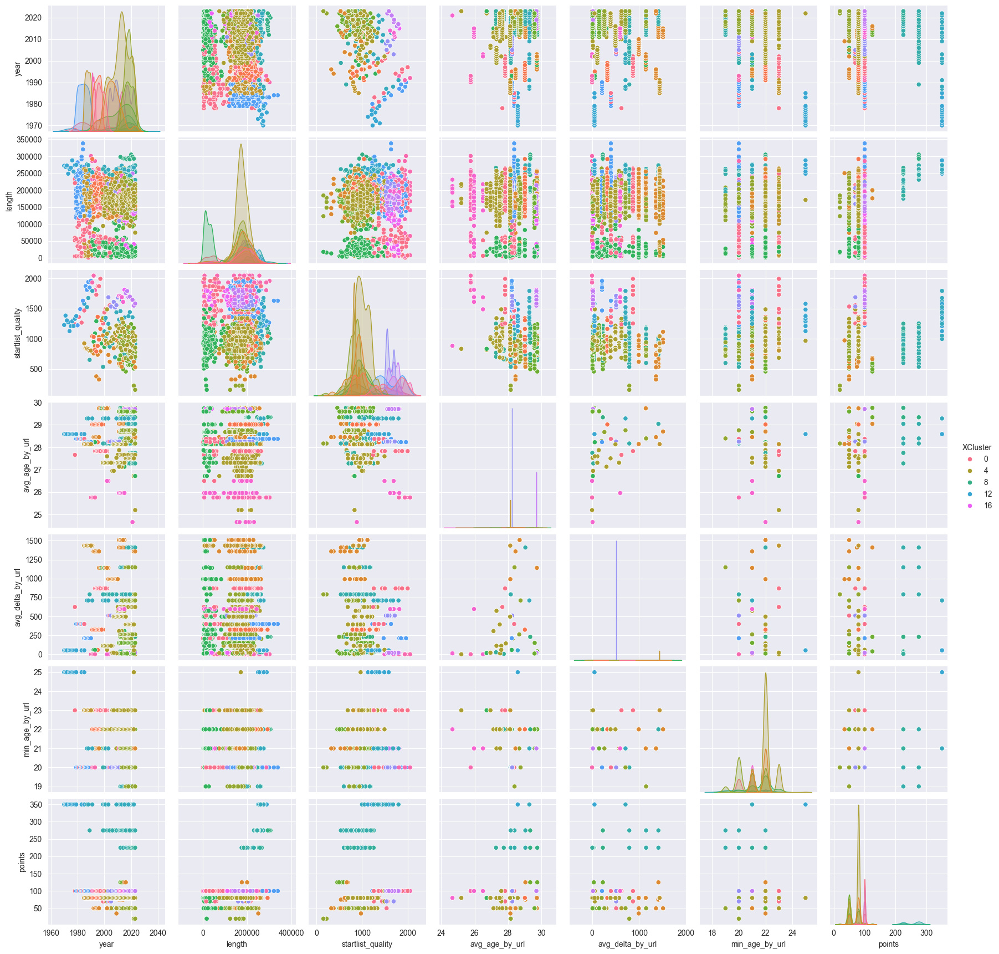

In [34]:
labels, centroid = clustering.x_means(real_stages_df)

print(f"Silouette: {silhouette_score(real_stages_df, labels)}")

clustering.optimal_pair_plot(stages, 'XCluster', labels)

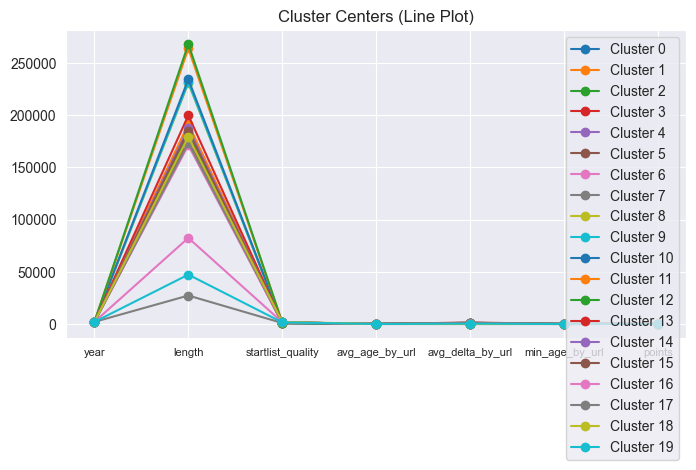

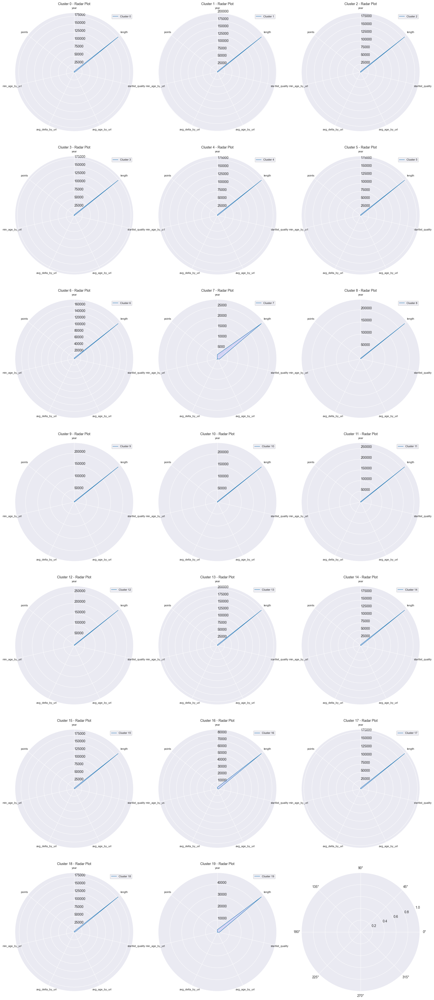

           year         length  startlist_quality  avg_age_by_url  \
0   1996.694444  177395.833333        1665.798611       27.825445   
1   1994.760274  191600.684932        1014.732877       29.012231   
2   2005.719231  181943.461538         858.715385       28.608177   
3   1987.614173  173268.503937         844.173228       28.140940   
4   2012.144776  176896.567164        1009.313433       27.562124   
5   2018.095563  176672.286689         830.075085       28.526762   
6   2017.481865  171236.269430         929.435233       29.645456   
7   2010.204545   27270.181818         950.063636       28.353812   
8   2017.968750  230718.750000         866.093750       29.523638   
9   2018.437500  231400.000000         948.000000       27.428950   
10  2015.065789  234326.315789         900.631579       28.570071   
11  2007.352941  263917.647059        1392.764706       29.286517   
12  1976.083333  268117.500000        1317.583333       28.588235   
13  1984.234375  199787.500000    

In [35]:
centers = clustering.inverse_transform(np.array(centroid), preprocessor_stages,
                                                      standardize_cols=stand_stage,
                                                      minmax_cols=minmax_stage,
                                                      categorical_cols=cat_stage)
clustering.plot_centers(stages, centers, 7, 3)
print(centers)

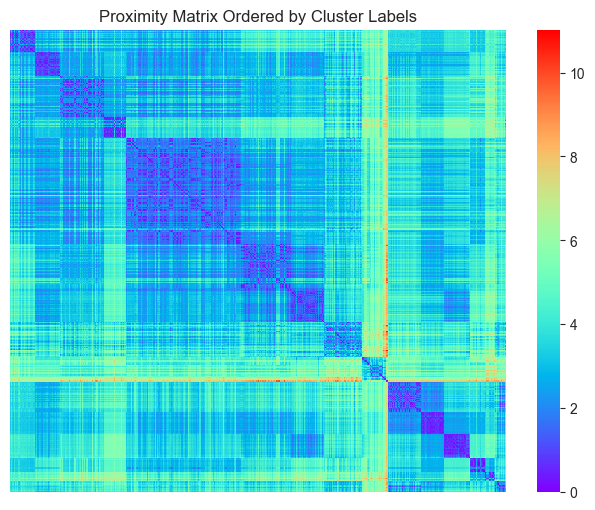

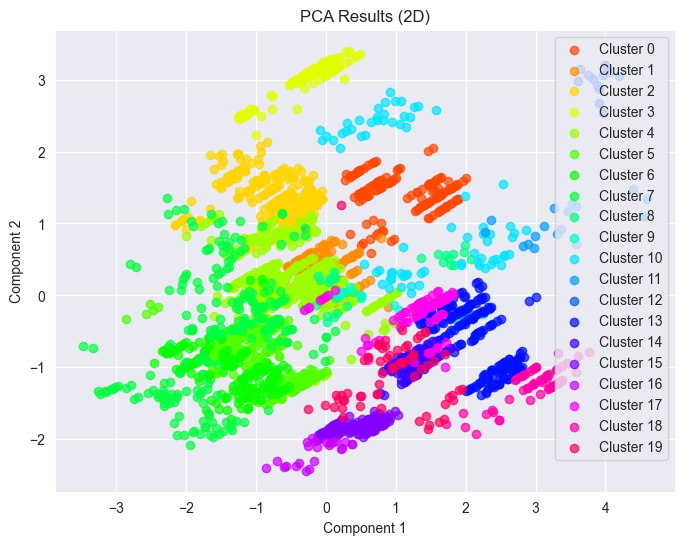

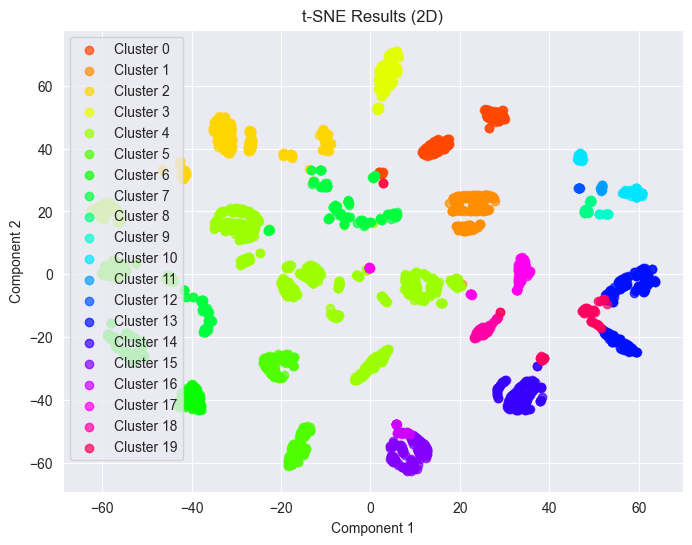

In [36]:
data_scaled = real_stages_df

clustering.similarity_matrix(real_stages_df, labels)
# 2D PCA
pca_2d = apply_pca(data_scaled, dimensions=2)
plot_results(pca_2d, labels, title="PCA Results (2D)", dimensions=2)

# 2D t-SNE
tsne_2d = apply_tsne(data_scaled, dimensions=2)
plot_results(tsne_2d, labels, title="t-SNE Results (2D)", dimensions=2)

## Hierarchical 

Define linkage methods to try

In [37]:
# Let's use methods less susceptible to outliers and noise
# linkage_methods = ["single", "complete", "average", "ward", "centroid", "median"]
linkage_methods = ["average", "ward", "centroid"]

### Cyclists link

Compute distance matrices for cyclists

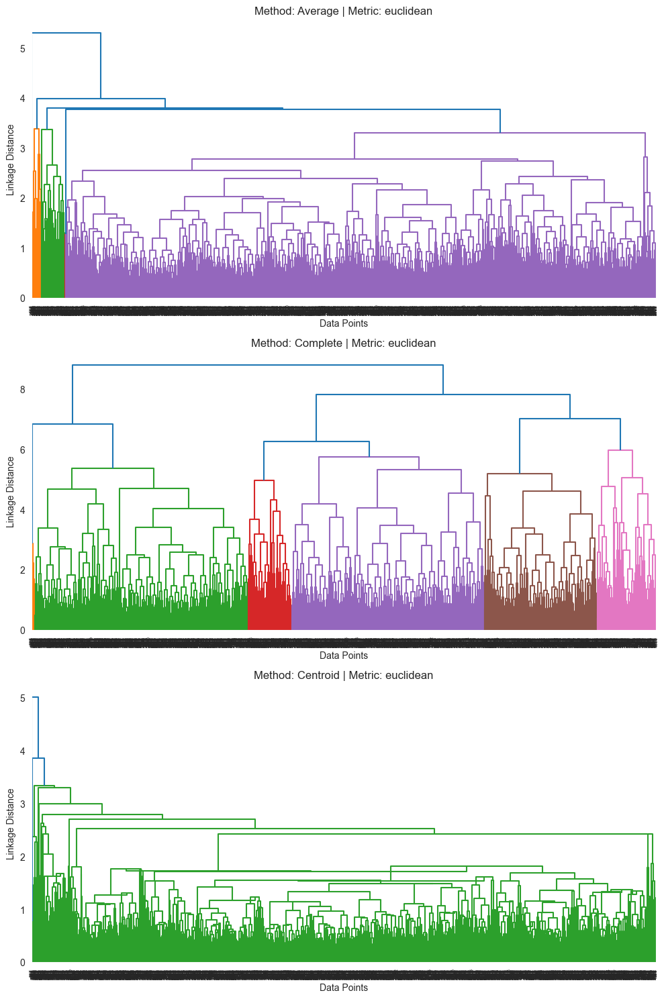

In [38]:
dst_matrix_euclid_cyclists = clustering.compute_distance_matrix(real_cyclists_df,"euclidean")
euclid_link = clustering.compute_hc(dst_matrix_euclid_cyclists, methods=['average', 'complete', 'centroid'])
clustering.plot_all_hc(euclid_link, "euclidean")

### Stages links

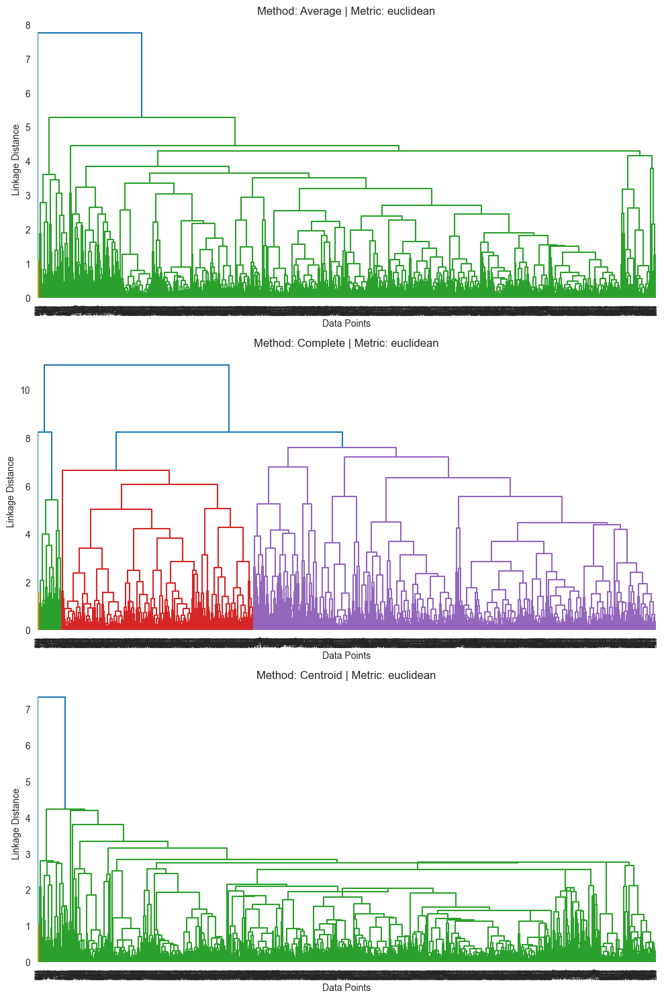

In [39]:
dst_matrix_euclid_stages = clustering.compute_distance_matrix(real_stages_df, "euclidean")
euclid_link = clustering.compute_hc(dst_matrix_euclid_stages, methods=['average', 'complete', 'centroid'])
clustering.plot_all_hc(euclid_link, "euclidean")

Can't identify clearly where should be cut (number of clusters). Let's try another method

### Spectral method

According to spectral method. No clusters are found

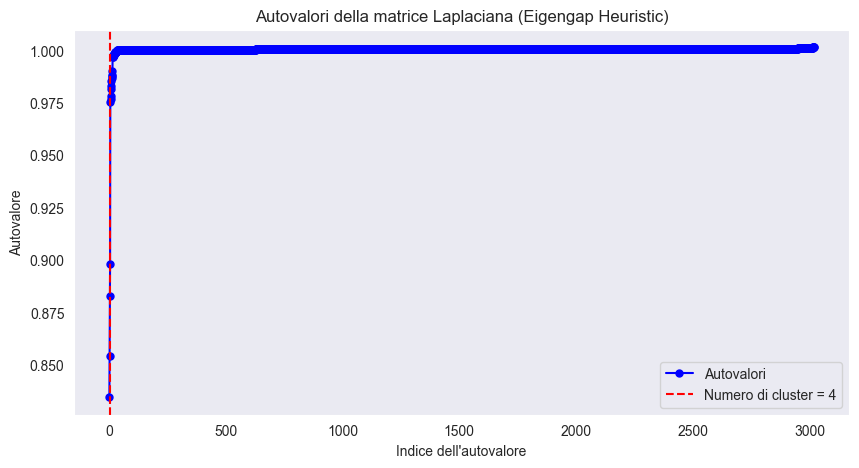

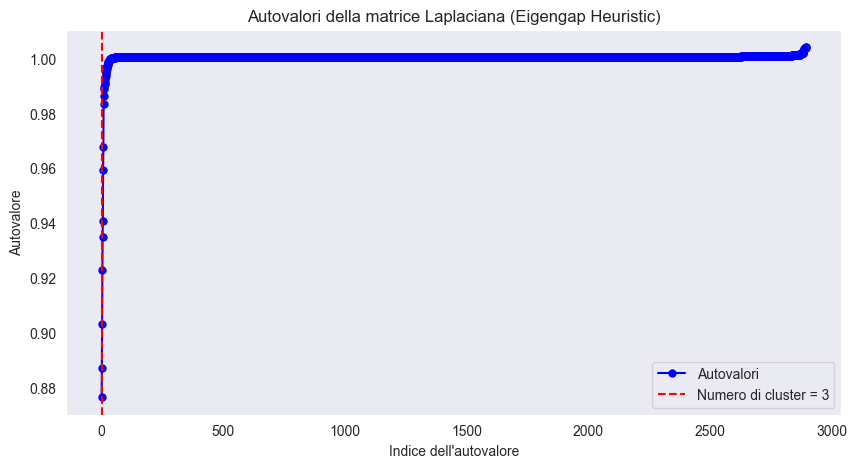

In [40]:
import libraries.clustering as clustering
clustering.spectral_eigen_gap(real_cyclists_df.values)
clustering.spectral_eigen_gap(real_stages_df.values)

### Cyclists agglomerative

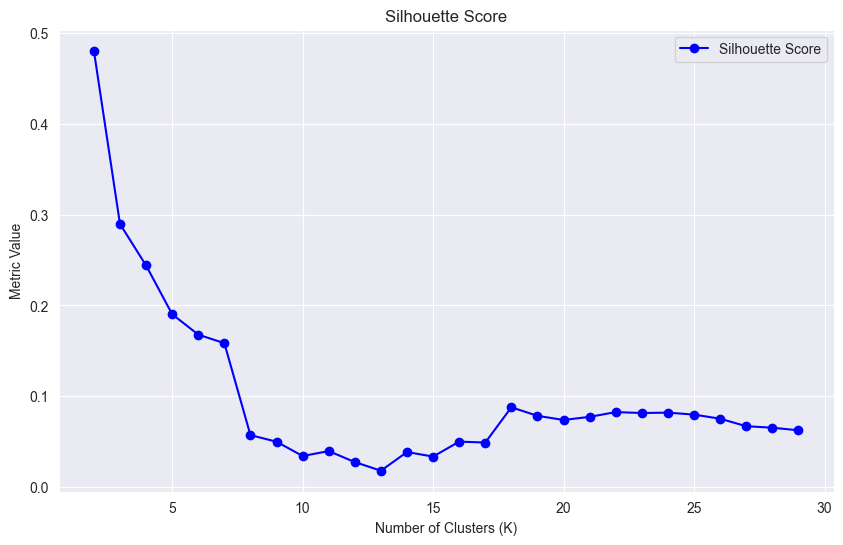

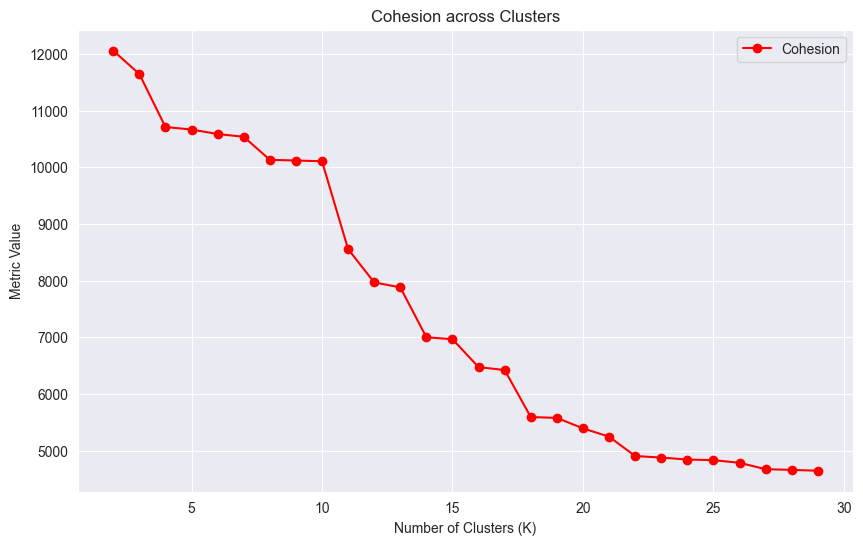

In [41]:
from sklearn.cluster import AgglomerativeClustering

agglr_labels_cyclists = []
for num_clusters in range(2, 30):
    agg_clustering = AgglomerativeClustering(n_clusters=num_clusters, linkage='average')
    agglr_labels_cyclists.append(agg_clustering.fit_predict(real_cyclists_df))

sil1,coh1 = sil_vs_coh(real_cyclists_df, agglr_labels_cyclists, list(range(2,30)))

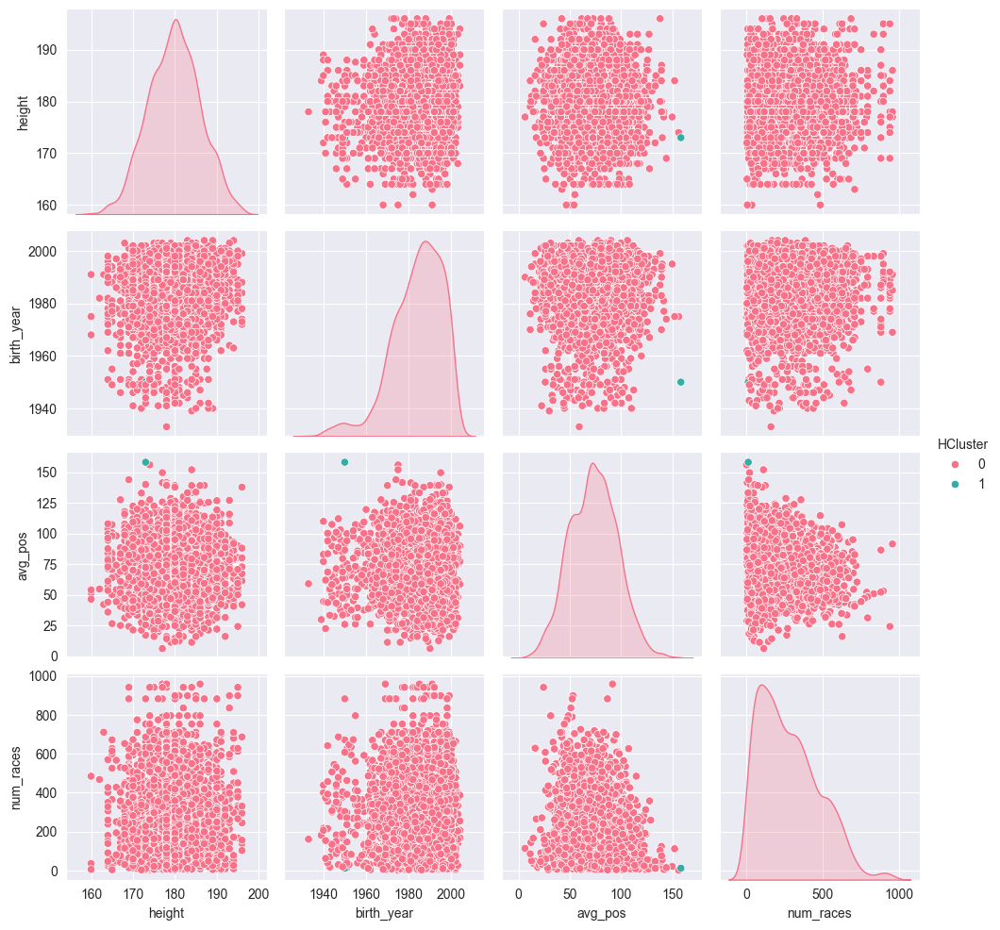

In [42]:
agg_clustering = AgglomerativeClustering(n_clusters=2, linkage='average')
labels = agg_clustering.fit_predict(real_cyclists_df)
clustering.optimal_pair_plot(cyclists, 'HCluster', labels)

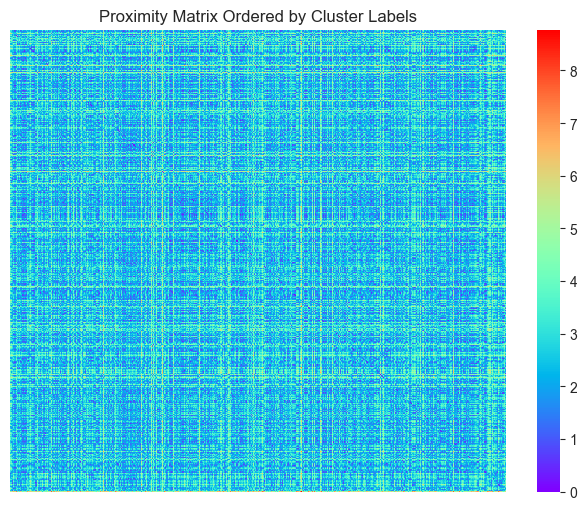

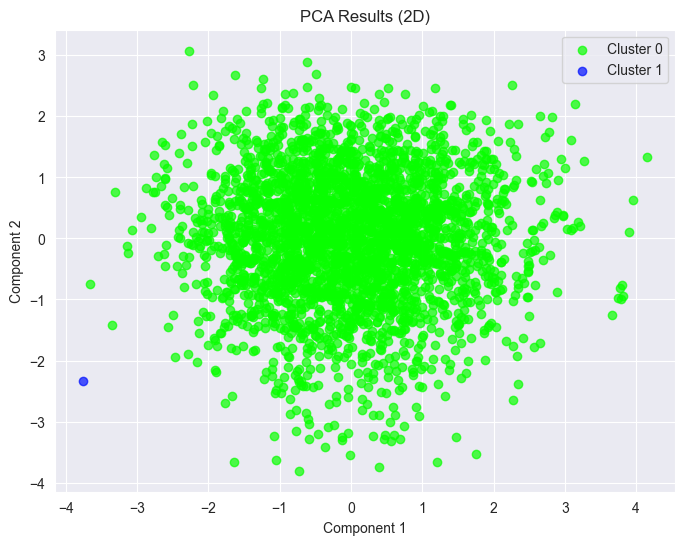

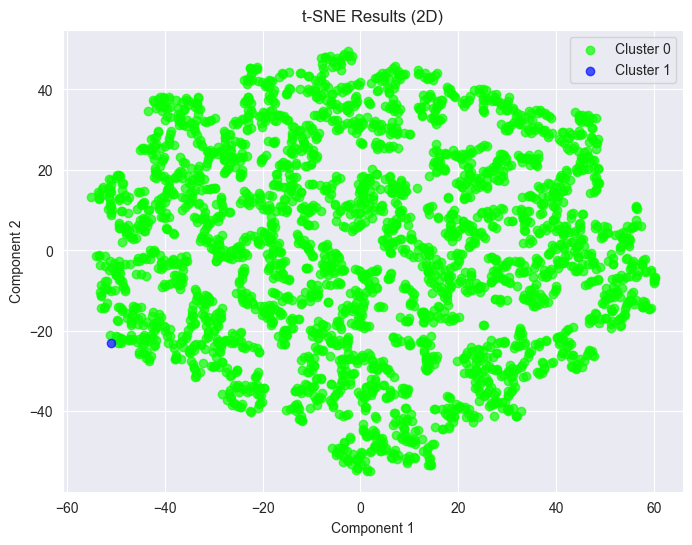

In [43]:
data_scaled = real_cyclists_df

clustering.similarity_matrix(real_cyclists_df, labels)
# 2D PCA
pca_2d = apply_pca(data_scaled, dimensions=2)
plot_results(pca_2d, labels, title="PCA Results (2D)", dimensions=2)

# 2D t-SNE
tsne_2d = apply_tsne(data_scaled, dimensions=2)
plot_results(tsne_2d, labels, title="t-SNE Results (2D)", dimensions=2)

### Stages agglomerative

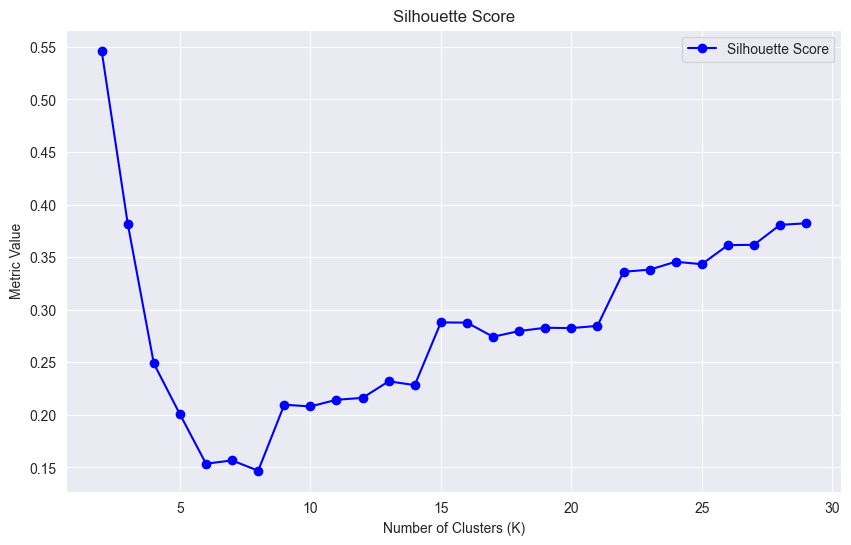

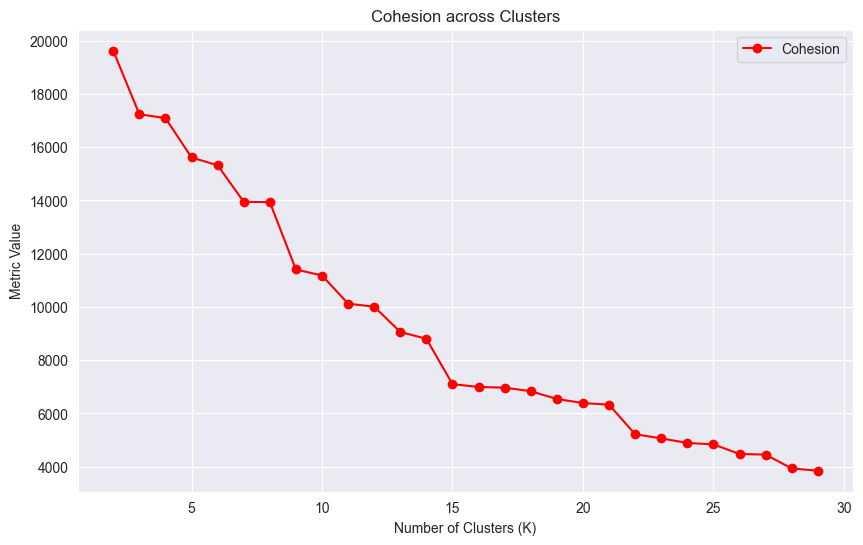

In [44]:
from sklearn.cluster import AgglomerativeClustering

agglr_labels_stages = []
for num_clusters in range(2, 30):
    agg_clustering = AgglomerativeClustering(n_clusters=num_clusters, linkage='average')
    agglr_labels_stages.append(agg_clustering.fit_predict(real_stages_df))

sil1,coh1 = sil_vs_coh(real_stages_df, agglr_labels_stages, list(range(2,30)))

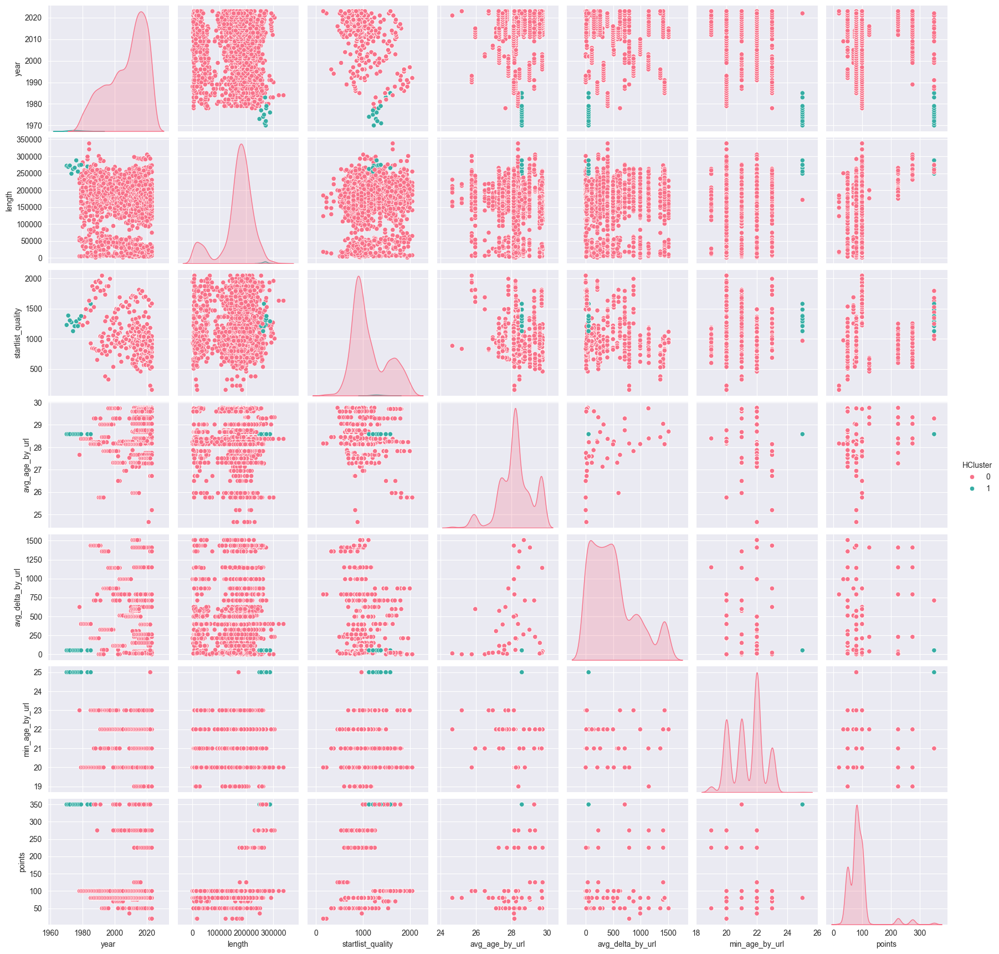

In [45]:
agg_clustering = AgglomerativeClustering(n_clusters=2, linkage='average')
labels = agg_clustering.fit_predict(real_stages_df)
clustering.optimal_pair_plot(stages, 'HCluster', labels)

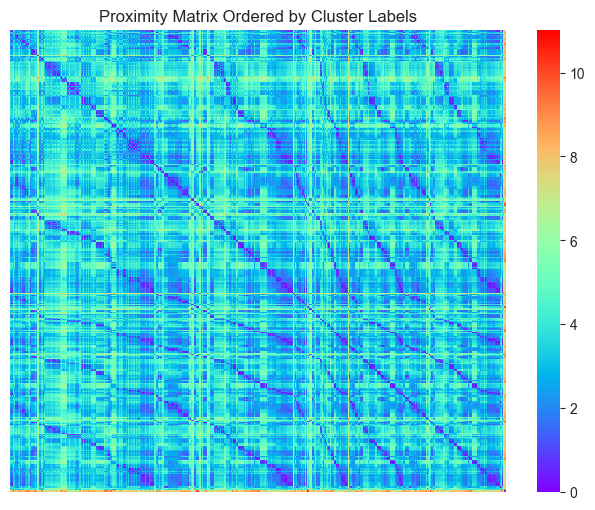

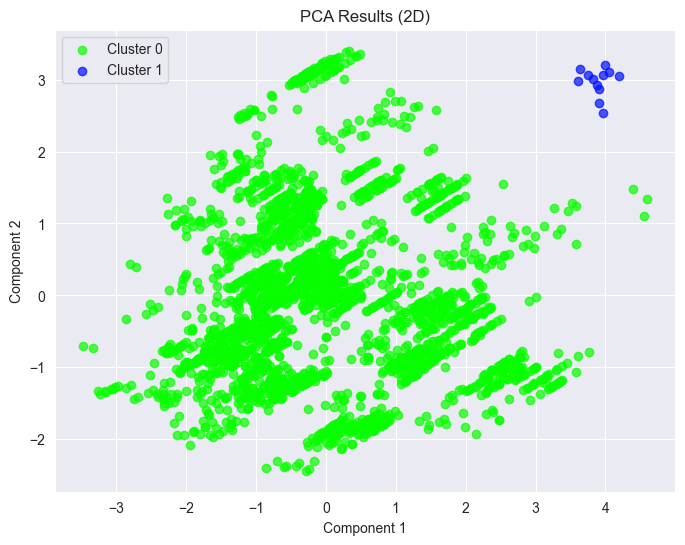

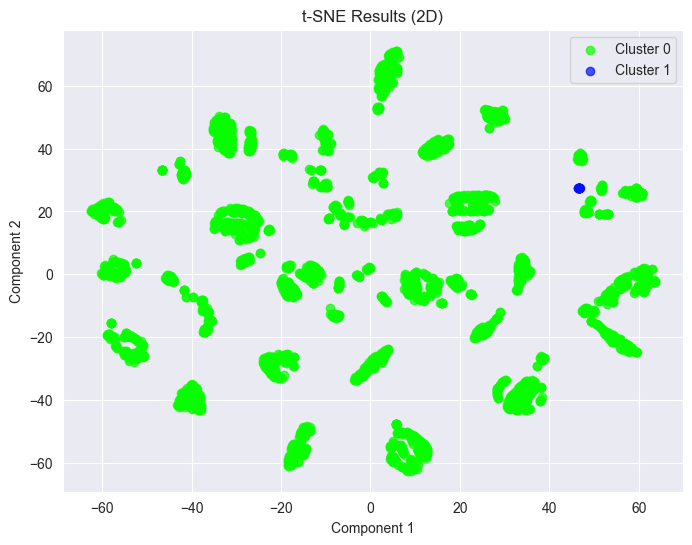

In [46]:
data_scaled = real_stages_df

clustering.similarity_matrix(real_stages_df, labels)
# 2D PCA
pca_2d = apply_pca(data_scaled, dimensions=2)
plot_results(pca_2d, labels, title="PCA Results (2D)", dimensions=2)

# 2D t-SNE
tsne_2d = apply_tsne(data_scaled, dimensions=2)
plot_results(tsne_2d, labels, title="t-SNE Results (2D)", dimensions=2)

### Cyclists spectral

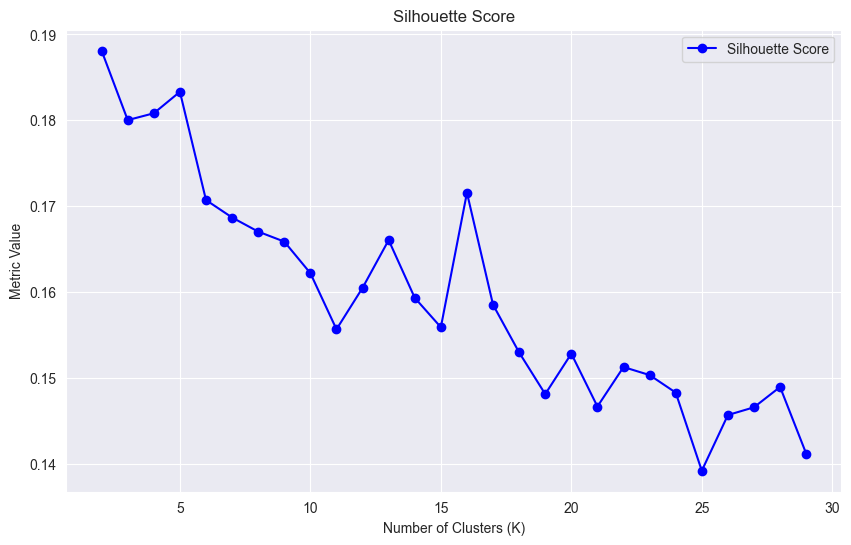

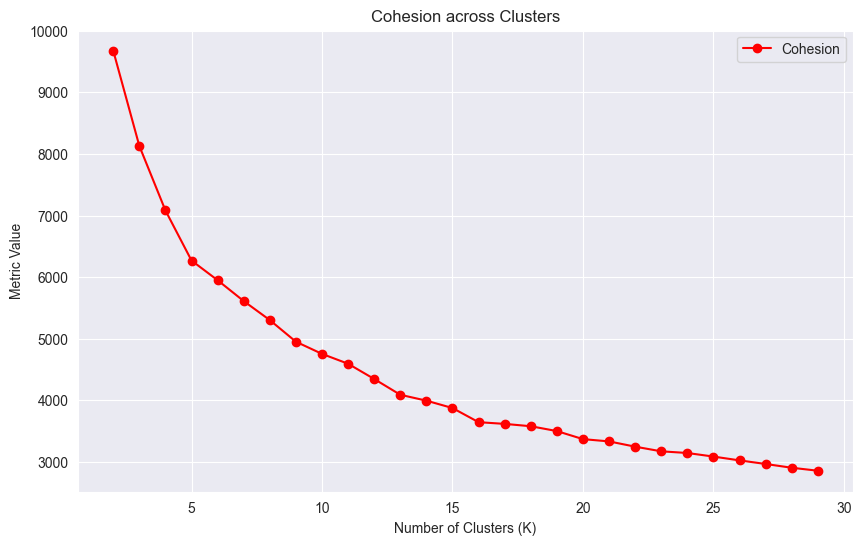

In [47]:
spect_labels_cyclists = []
for n_clusters in range(2, 30):
    spectral = SpectralClustering(n_clusters=n_clusters, affinity='nearest_neighbors', random_state=1804)
    spect_labels_cyclists.append(spectral.fit_predict(real_cyclists_df))

sil3,coh3 = sil_vs_coh(real_cyclists_df, spect_labels_cyclists, list(range(2,30)))

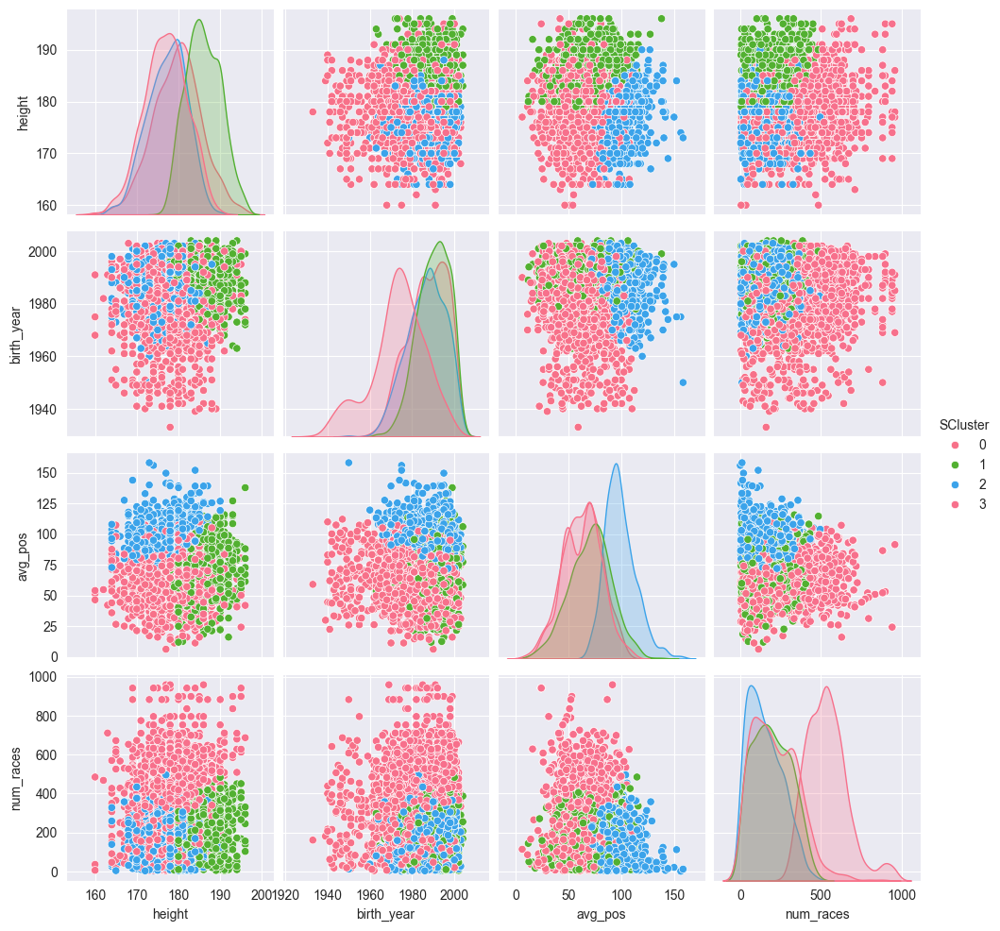

In [48]:
spect_clustering = SpectralClustering(n_clusters=4, affinity='nearest_neighbors', random_state=1804)
labels = spect_clustering.fit_predict(real_cyclists_df)
clustering.optimal_pair_plot(cyclists, 'SCluster', labels)

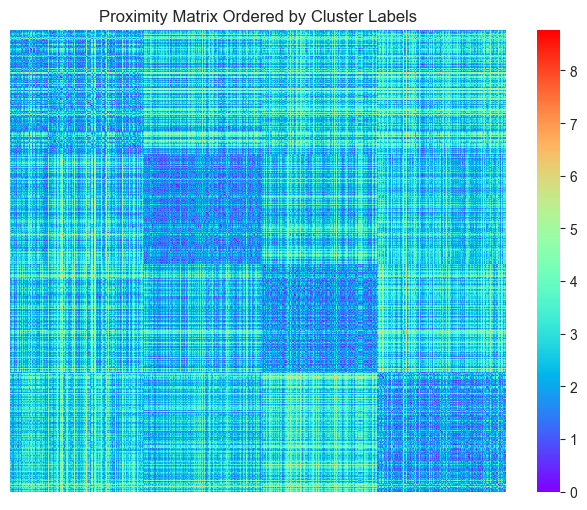

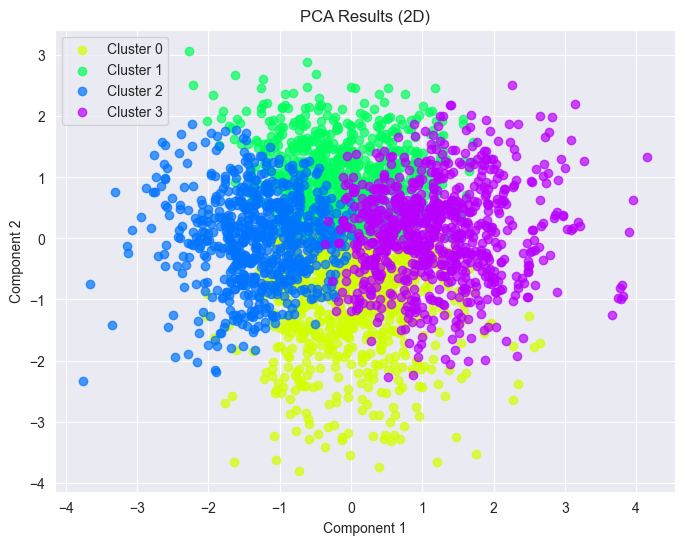

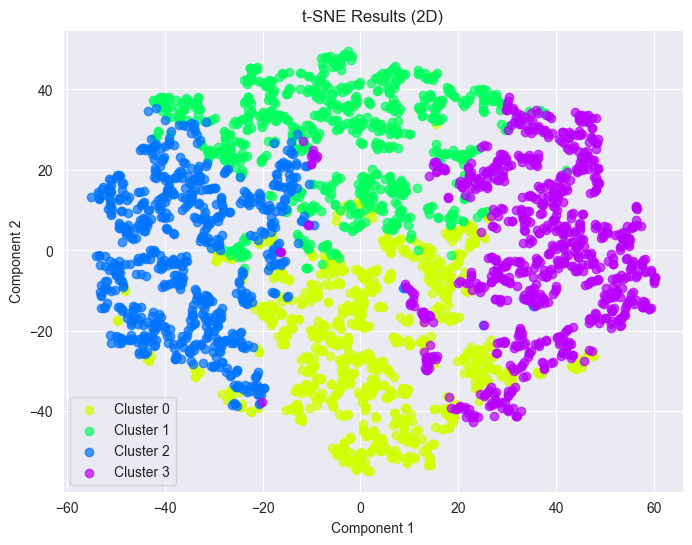

In [49]:
data_scaled = real_cyclists_df

clustering.similarity_matrix(real_cyclists_df, labels)
# 2D PCA
pca_2d = apply_pca(data_scaled, dimensions=2)
plot_results(pca_2d, labels, title="PCA Results (2D)", dimensions=2)

# 2D t-SNE
tsne_2d = apply_tsne(data_scaled, dimensions=2)
plot_results(tsne_2d, labels, title="t-SNE Results (2D)", dimensions=2)

### Stages spectral

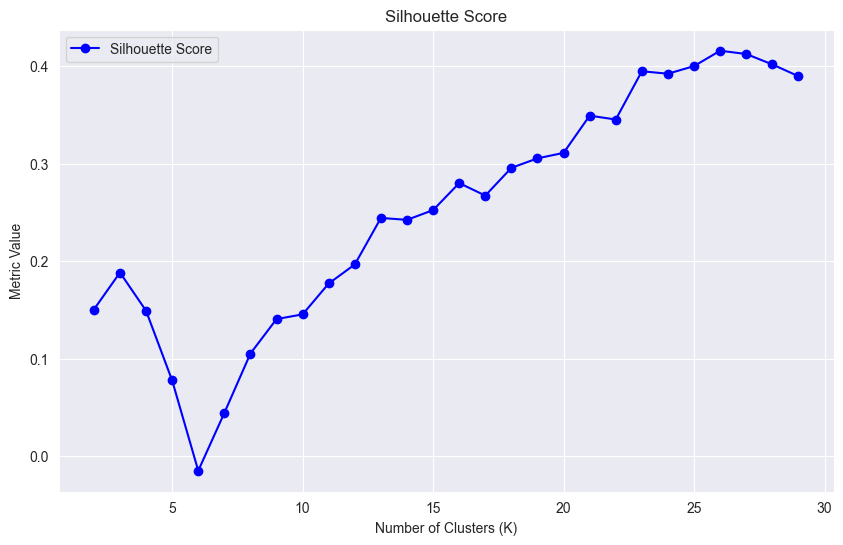

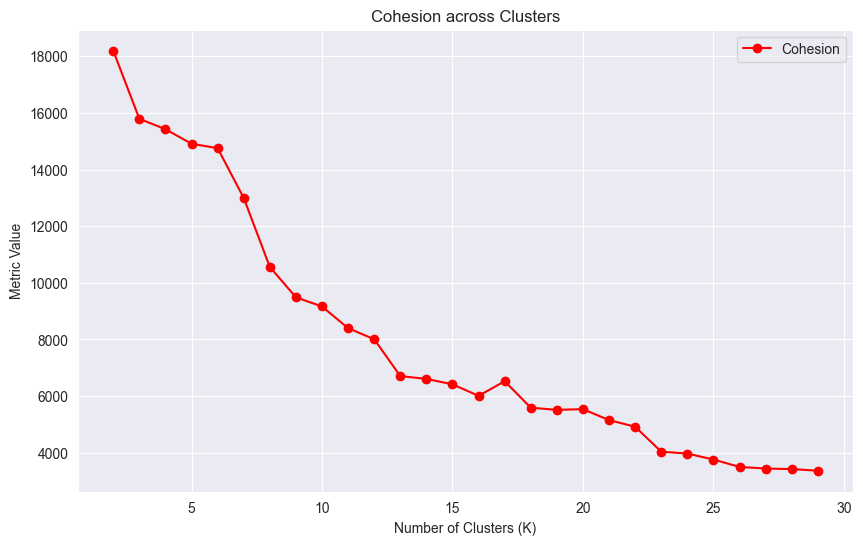

In [50]:
from sklearn.cluster import SpectralClustering

spect_labels_stages = []
for n_clusters in range(2, 30):
    spectral = SpectralClustering(n_clusters=n_clusters, affinity='nearest_neighbors', n_neighbors=50, random_state=1804)
    spect_labels_stages.append(spectral.fit_predict(real_stages_df))

sil4,coh4 = sil_vs_coh(real_stages_df, spect_labels_stages, list(range(2,30)))

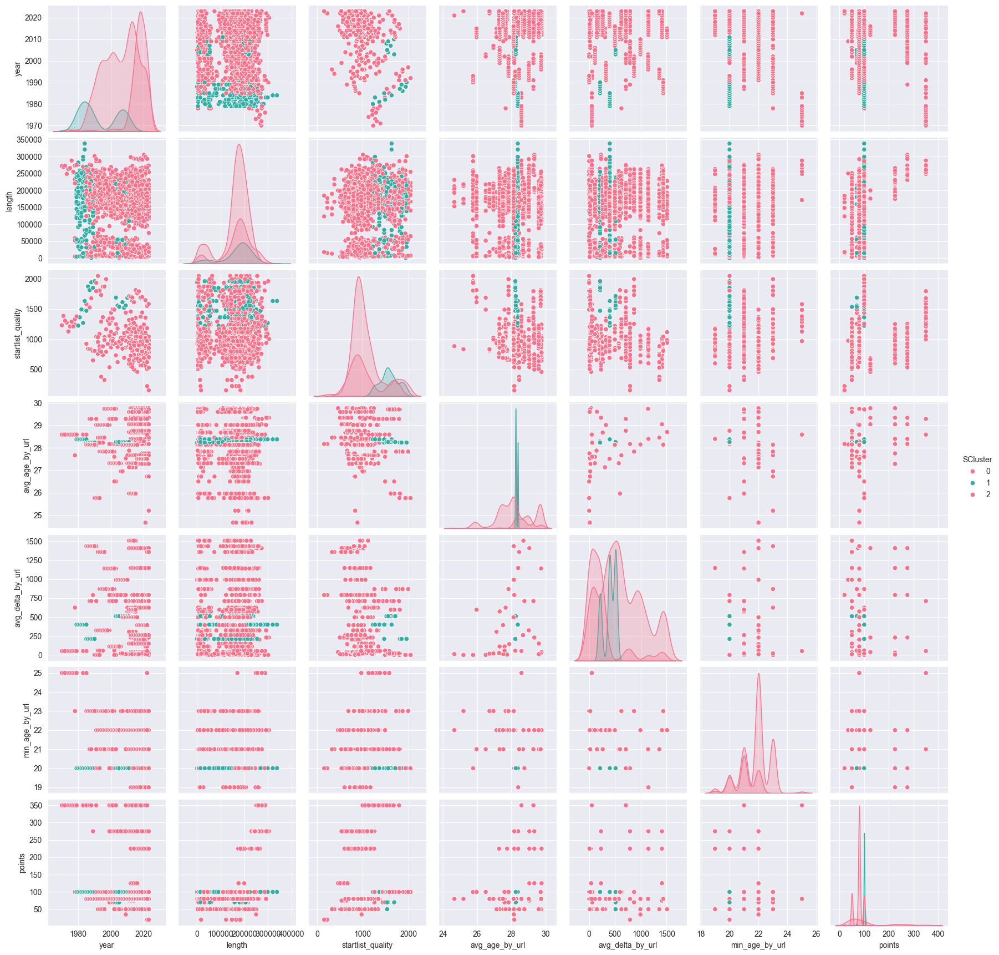

In [51]:
spect_clustering = SpectralClustering(n_clusters=3, affinity='nearest_neighbors', n_neighbors=50, random_state=1804)
labels = spect_clustering.fit_predict(real_stages_df)
clustering.optimal_pair_plot(stages, 'SCluster', labels)

Note: Spectral clustering detects isolated points for stages with KNN

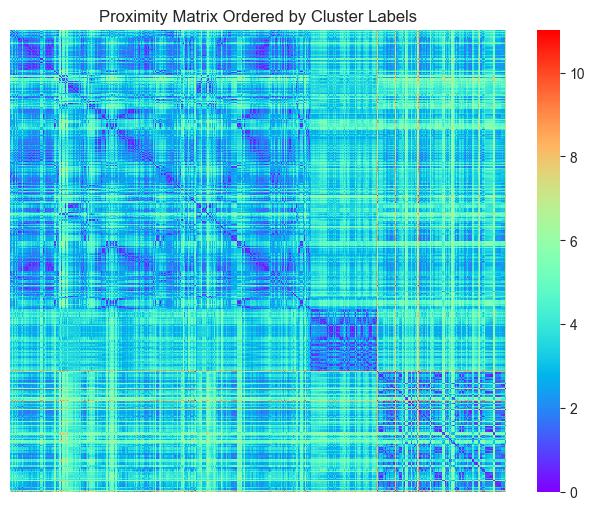

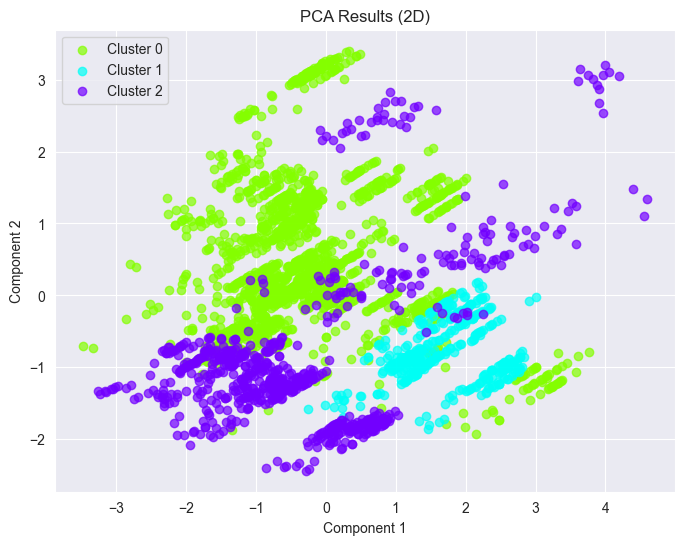

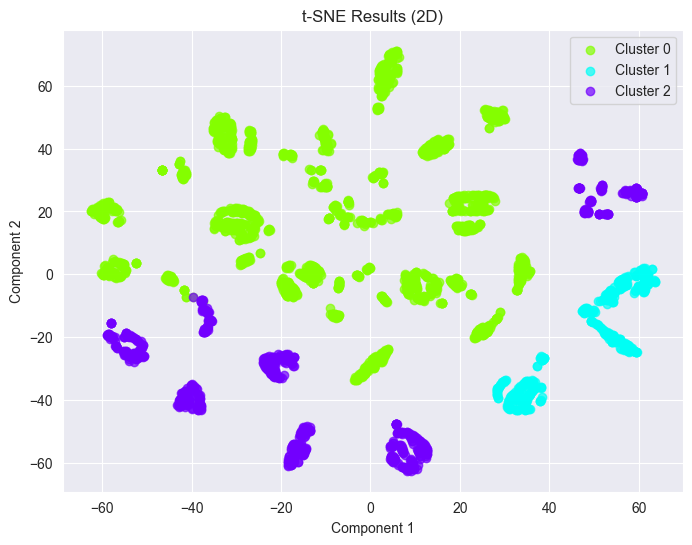

In [52]:
data_scaled = real_stages_df

clustering.similarity_matrix(real_stages_df, labels)
# 2D PCA
pca_2d = apply_pca(data_scaled, dimensions=2)
plot_results(pca_2d, labels, title="PCA Results (2D)", dimensions=2)

# 2D t-SNE
tsne_2d = apply_tsne(data_scaled, dimensions=2)
plot_results(tsne_2d, labels, title="t-SNE Results (2D)", dimensions=2)

## DBscan

### Cyclists

In [53]:
dst_matrix_euclid_cyclists = clustering.compute_distance_matrix(real_cyclists_df,"euclidean")
dst_matrix_euclid_cyclists = squareform(dst_matrix_euclid_cyclists)
ks = [real_cyclists_df.shape[1] * 2]

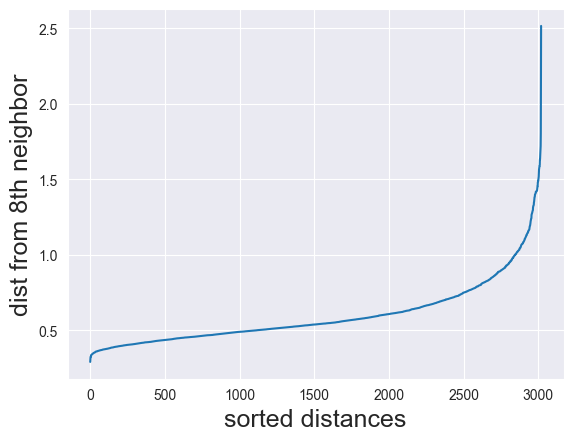

In [54]:
for dist, k in zip([dst_matrix_euclid_cyclists], ks):
    kth_distances = list()
    for d in dist:
        index_kth_distance = np.argsort(d)[k]
        kth_distances.append(d[index_kth_distance])

    plt.plot(range(0, len(kth_distances)), sorted(kth_distances))
    plt.ylabel("dist from %sth neighbor" % k, fontsize=18)
    plt.xlabel("sorted distances", fontsize=18)
    plt.show()

     eps  Clusters   Noise
0   0.50       4.0  2065.0
1   0.51       4.0  1935.0
2   0.52       2.0  1789.0
3   0.53       3.0  1686.0
4   0.54       3.0  1607.0
5   0.55       3.0  1489.0
6   0.56       1.0  1374.0
7   0.57       1.0  1276.0
8   0.58       1.0  1212.0
9   0.59       2.0  1101.0
10  0.60       2.0  1027.0
11  0.61       2.0   935.0
12  0.62       2.0   871.0
13  0.63       2.0   791.0
14  0.64       2.0   721.0
15  0.65       2.0   689.0
16  0.66       2.0   647.0
17  0.67       1.0   585.0
18  0.68       1.0   535.0
19  0.69       1.0   504.0
20  0.70       1.0   474.0
21  0.71       1.0   448.0
22  0.72       1.0   419.0
23  0.73       1.0   395.0
24  0.74       1.0   373.0
25  0.75       1.0   356.0
26  0.76       1.0   332.0
27  0.77       1.0   315.0
28  0.78       1.0   301.0
29  0.79       1.0   285.0
30  0.80       1.0   267.0
31  0.81       1.0   248.0
32  0.82       1.0   235.0
33  0.83       1.0   225.0
34  0.84       1.0   217.0
35  0.85       1.0   206.0
3

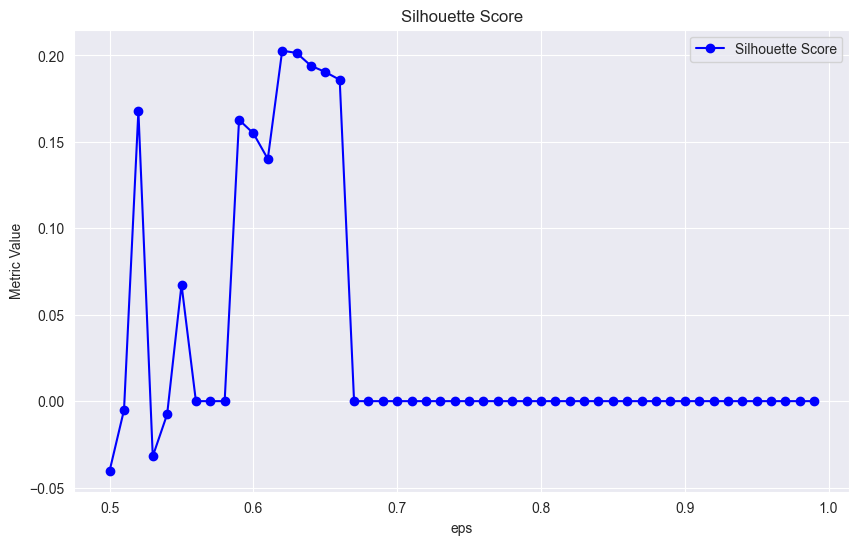

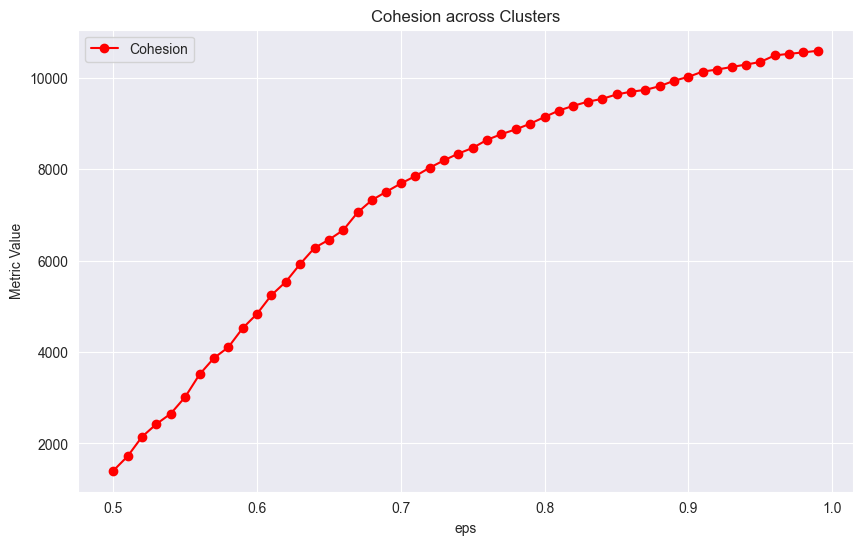

In [55]:
clustering.dbscan_tune(real_cyclists_df, dst_matrix_euclid_cyclists, np.arange(0.5, 1.0, 0.01))

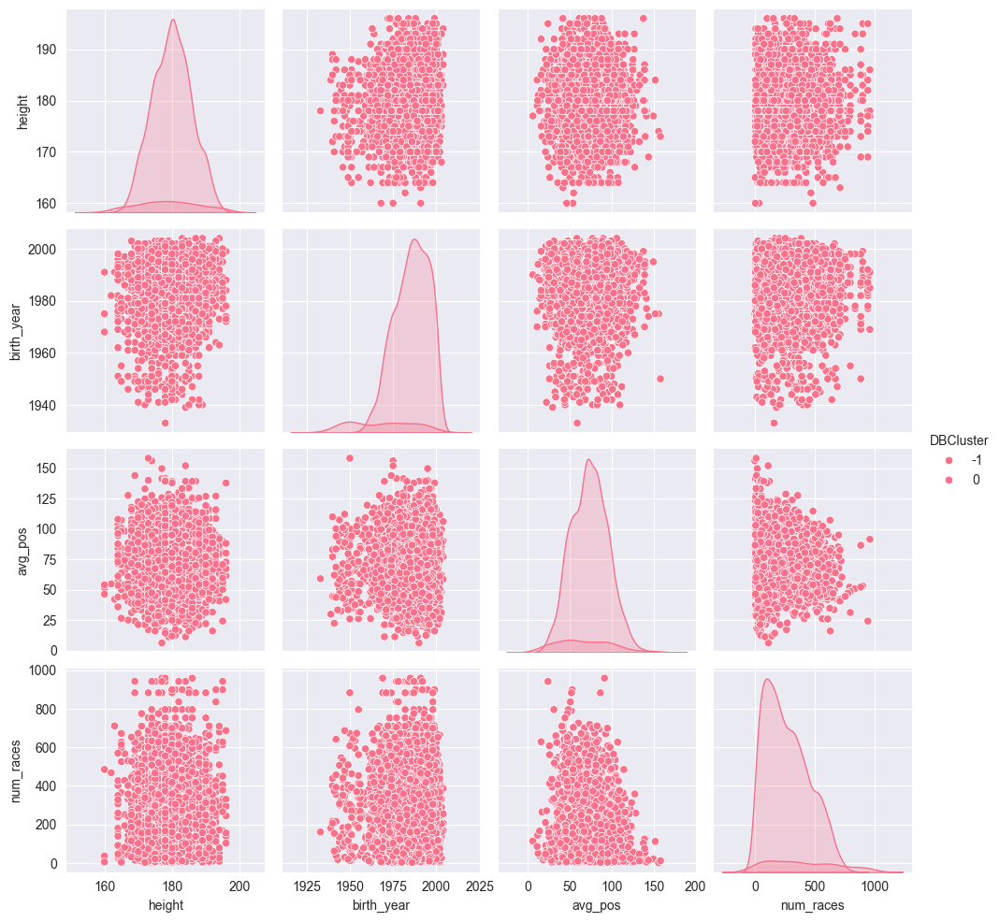

In [56]:
dbscan = DBSCAN(eps=0.63, min_samples=2*real_cyclists_df.shape[1], metric="precomputed", n_jobs=-1)
dbscan.fit_predict(dst_matrix_euclid_cyclists)
labels = dbscan.labels_

clustering.optimal_pair_plot(cyclists, 'DBCluster', labels)

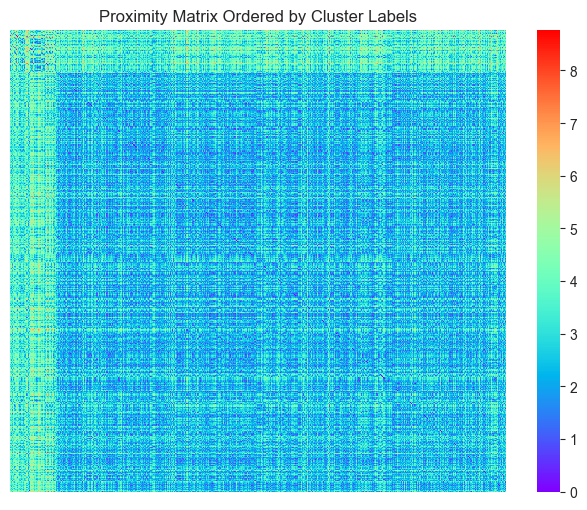

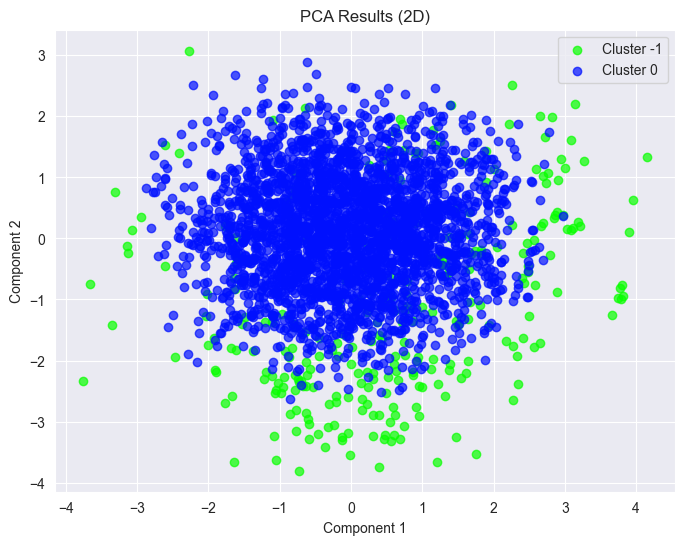

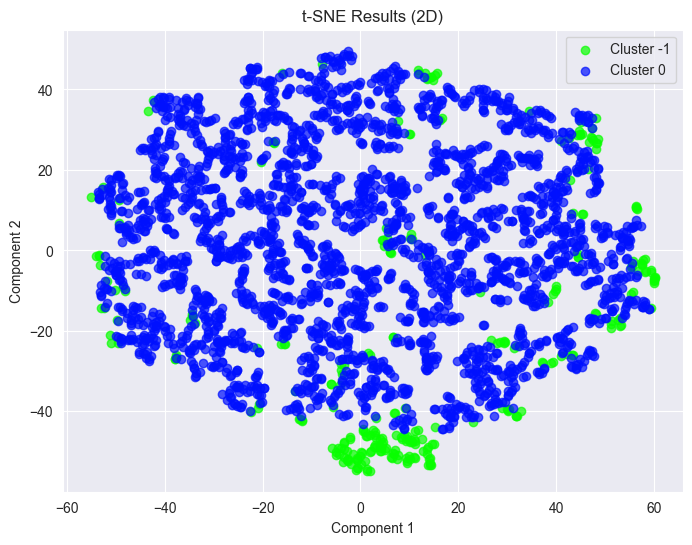

In [57]:
data_scaled = real_cyclists_df

clustering.similarity_matrix(real_cyclists_df, labels)

pca_2d = apply_pca(data_scaled, dimensions=2)
plot_results(pca_2d, labels, title="PCA Results (2D)", dimensions=2)

# 2D t-SNE
tsne_2d = apply_tsne(data_scaled, dimensions=2)
plot_results(tsne_2d, labels, title="t-SNE Results (2D)", dimensions=2)

### Stages

In [58]:
dst_matrix_euclid_stages = clustering.compute_distance_matrix(real_stages_df, "euclidean")
dst_matrix_euclid_stages = squareform(dst_matrix_euclid_stages)
ks = [real_stages_df.shape[1] * 2]

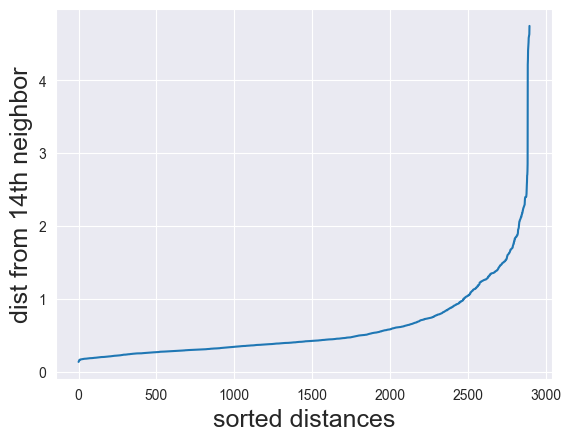

In [59]:
for dist, k in zip([dst_matrix_euclid_stages], ks):
    kth_distances = list()
    for d in dist:
        index_kth_distance = np.argsort(d)[k]
        kth_distances.append(d[index_kth_distance])

    plt.plot(range(0, len(kth_distances)), sorted(kth_distances))
    plt.ylabel("dist from %sth neighbor" % k, fontsize=18)
    plt.xlabel("sorted distances", fontsize=18)
    plt.show()

     eps  Clusters   Noise
0   0.80       2.0  2587.0
1   0.81       2.0  2583.0
2   0.82       3.0  2490.0
3   0.83       3.0  2484.0
4   0.84       3.0  2459.0
..   ...       ...     ...
65  1.45       4.0   983.0
66  1.46       4.0   953.0
67  1.47       4.0   942.0
68  1.48       4.0   925.0
69  1.49       4.0   917.0

[70 rows x 3 columns]


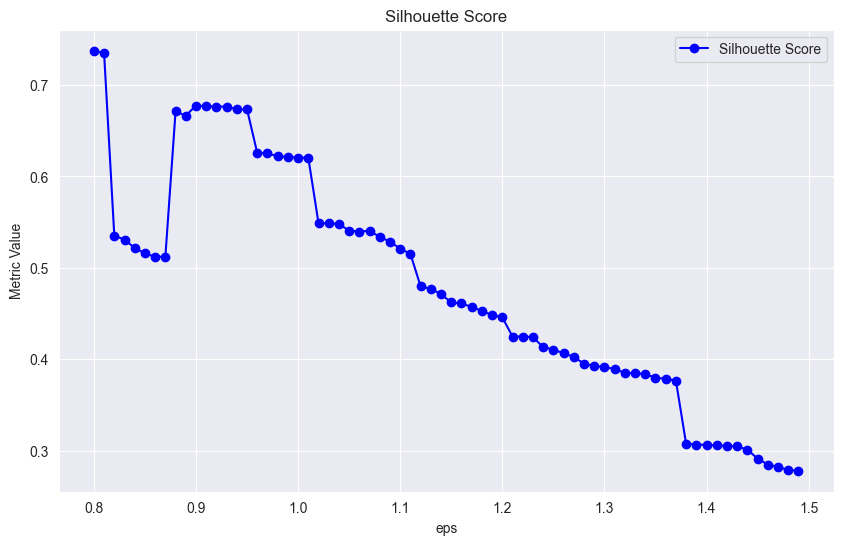

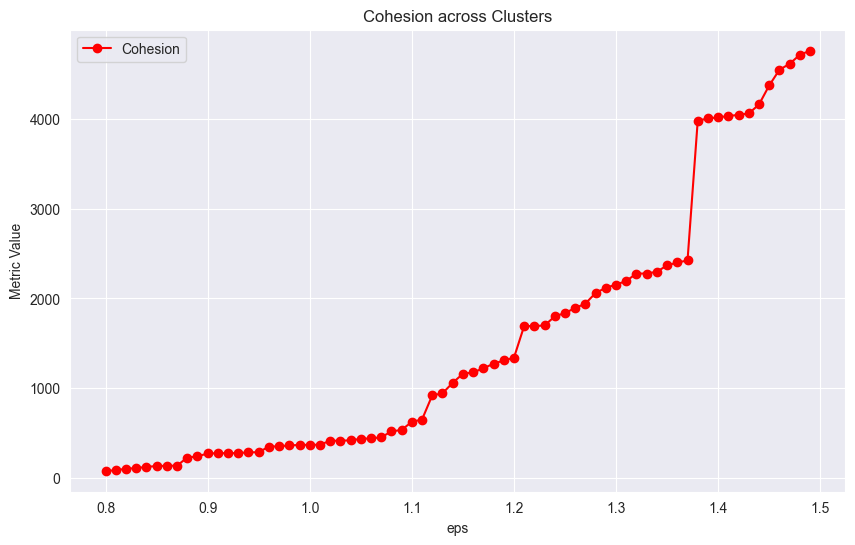

In [60]:
clustering.dbscan_tune(real_stages_df, dst_matrix_euclid_stages, np.arange(0.8, 1.5, 0.01))

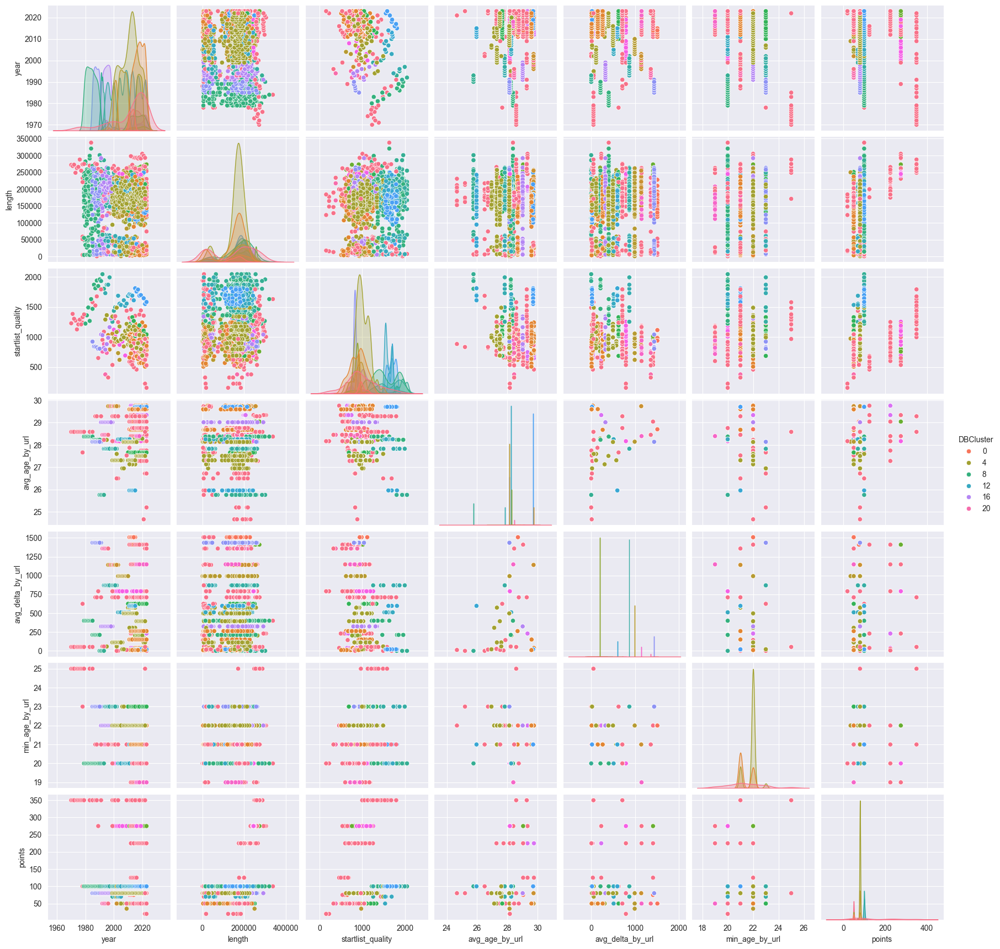

In [61]:
dbscan = DBSCAN(eps=1.1, min_samples=2*real_stages_df.shape[1], metric="precomputed", n_jobs=-1)
dbscan.fit_predict(dst_matrix_euclid_stages)
labels = dbscan.labels_

clustering.optimal_pair_plot(stages, 'DBCluster', labels)

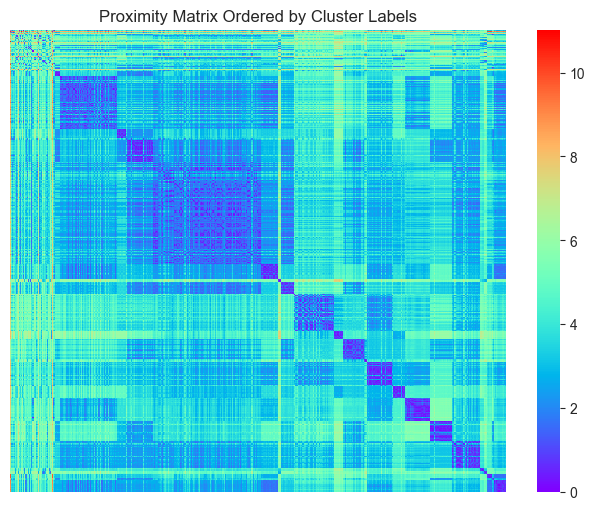

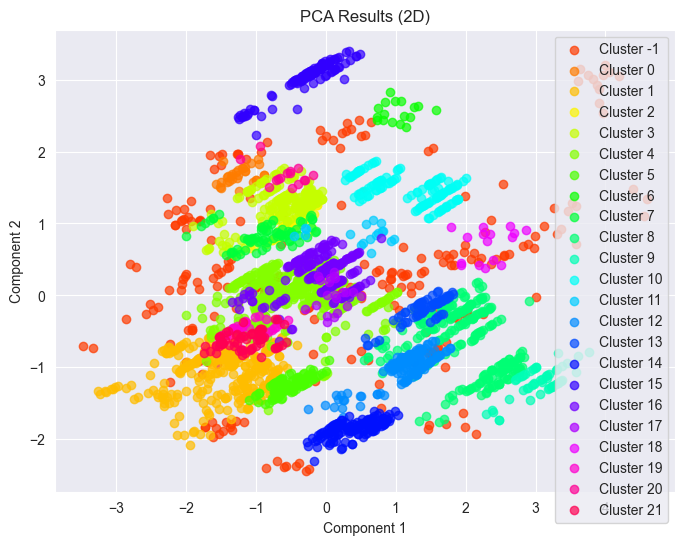

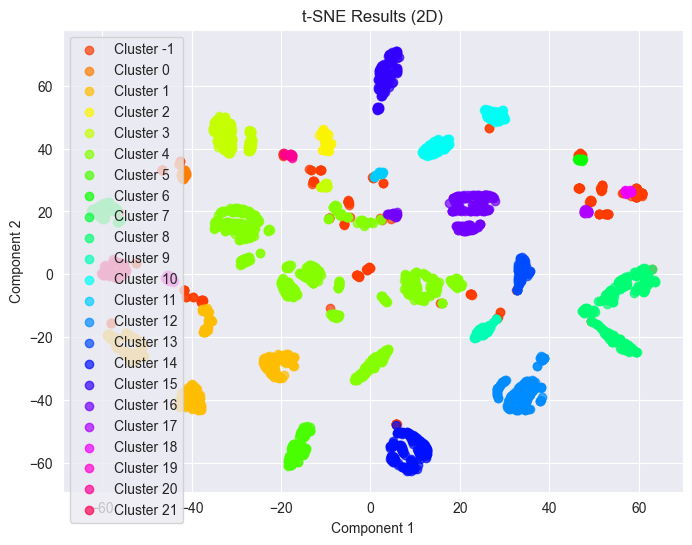

In [62]:
data_scaled = real_stages_df

clustering.similarity_matrix(real_stages_df, labels)
# 2D PCA
pca_2d = apply_pca(data_scaled, dimensions=2)
plot_results(pca_2d, labels, title="PCA Results (2D)", dimensions=2)

# 2D t-SNE
tsne_2d = apply_tsne(data_scaled, dimensions=2)
plot_results(tsne_2d, labels, title="t-SNE Results (2D)", dimensions=2)

### Optics
Tuning according to https://www.sefidian.com/2022/12/18/how-to-determine-epsilon-and-minpts-parameters-of-dbscan-clustering/#:~:text=A%20value%20of%20MinPts%20%3D%202,largest%20to%20the%20smallest%20value.

### Optics Cyclists

Hyperparameters tuning

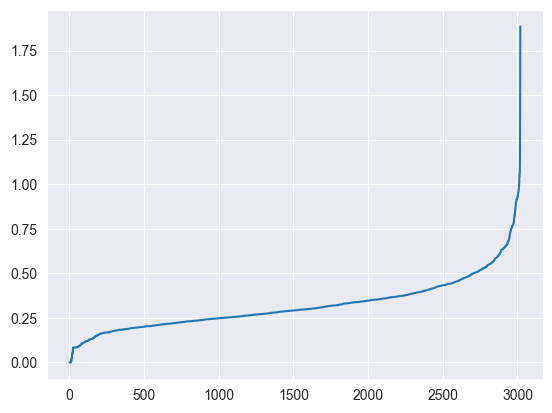

In [63]:
from sklearn.neighbors import NearestNeighbors
neighbors = NearestNeighbors(n_neighbors=real_cyclists_df.shape[1]*2)
neighbors_fit = neighbors.fit(real_cyclists_df)
distances, indices = neighbors_fit.kneighbors(real_cyclists_df)
distances = np.sort(distances, axis=0)
distances = distances[:,1]
plt.plot(distances)

C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\sklearn\cluster\_optics.py:661: UserWarning: All reachability values are inf. Set a larger max_eps or all data will be considered outliers.
  warnings.warn(
C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\sklearn\cluster\_optics.py:661: UserWarning: All reachability values are inf. Set a larger max_eps or all data will be considered outliers.
  warnings.warn(
C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\sklearn\cluster\_optics.py:661: UserWarning: All reachability values are inf. Set a larger max_eps or all data will be considered outliers.
  warnings.warn(
C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\sklearn\cluster\_optics.py:661: UserWarning: All reachability values are inf. Set a larger max_eps or all data will be considered outliers.
  warnings.warn(


Results for different eps values:
     eps  Clusters   Noise
0   0.25       0.0  3020.0
1   0.26       0.0  3020.0
2   0.27       0.0  3020.0
3   0.28       0.0  3020.0
4   0.29       1.0  3012.0
5   0.30       1.0  3011.0
6   0.31       1.0  3011.0
7   0.32       3.0  2981.0
8   0.33       6.0  2952.0
9   0.34       9.0  2903.0
10  0.35      14.0  2833.0
11  0.36      15.0  2746.0
12  0.37      13.0  2687.0
13  0.38      12.0  2860.0
14  0.39      14.0  2825.0
15  0.40      16.0  2849.0
16  0.41      11.0  2866.0
17  0.42       9.0  2904.0
18  0.43       9.0  2907.0
19  0.44      10.0  2920.0
20  0.45      10.0  2918.0
21  0.46      11.0  2904.0
22  0.47       9.0  2926.0
23  0.48       9.0  2925.0
24  0.49      11.0  2896.0
25  0.50       9.0  2926.0
26  0.51       8.0  2939.0
27  0.52       6.0  2961.0
28  0.53       7.0  2952.0
29  0.54       6.0  2961.0
30  0.55       8.0  2936.0
31  0.56       8.0  2936.0
32  0.57       8.0  2936.0
33  0.58       8.0  2936.0
34  0.59       8.0  2

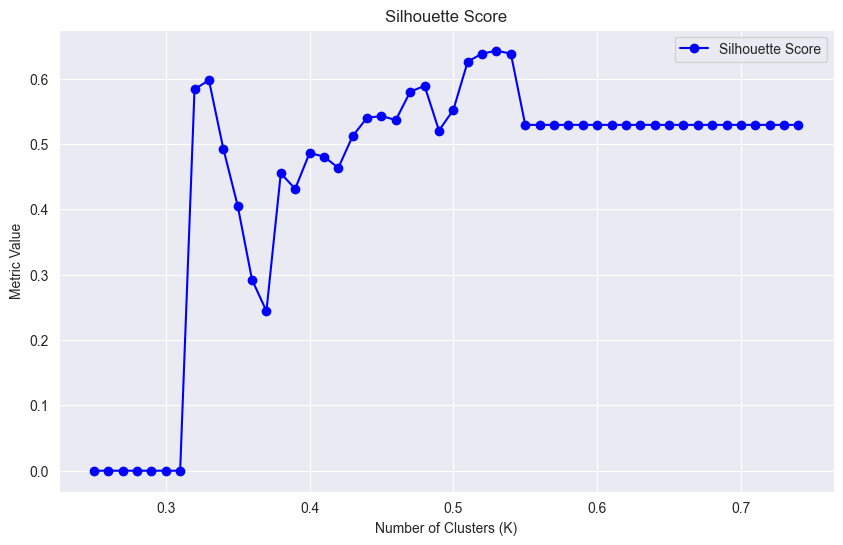

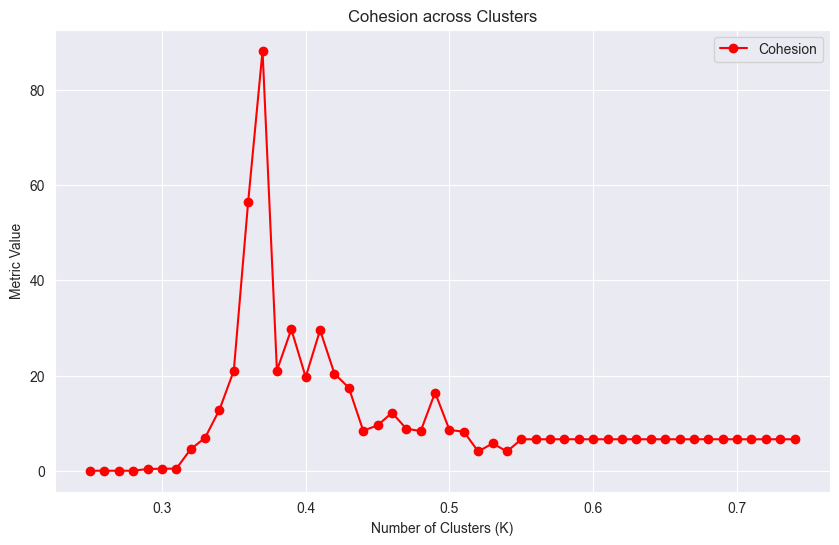

In [64]:
clustering.optics_tune(real_cyclists_df, np.arange(0.25, 0.75, 0.01))

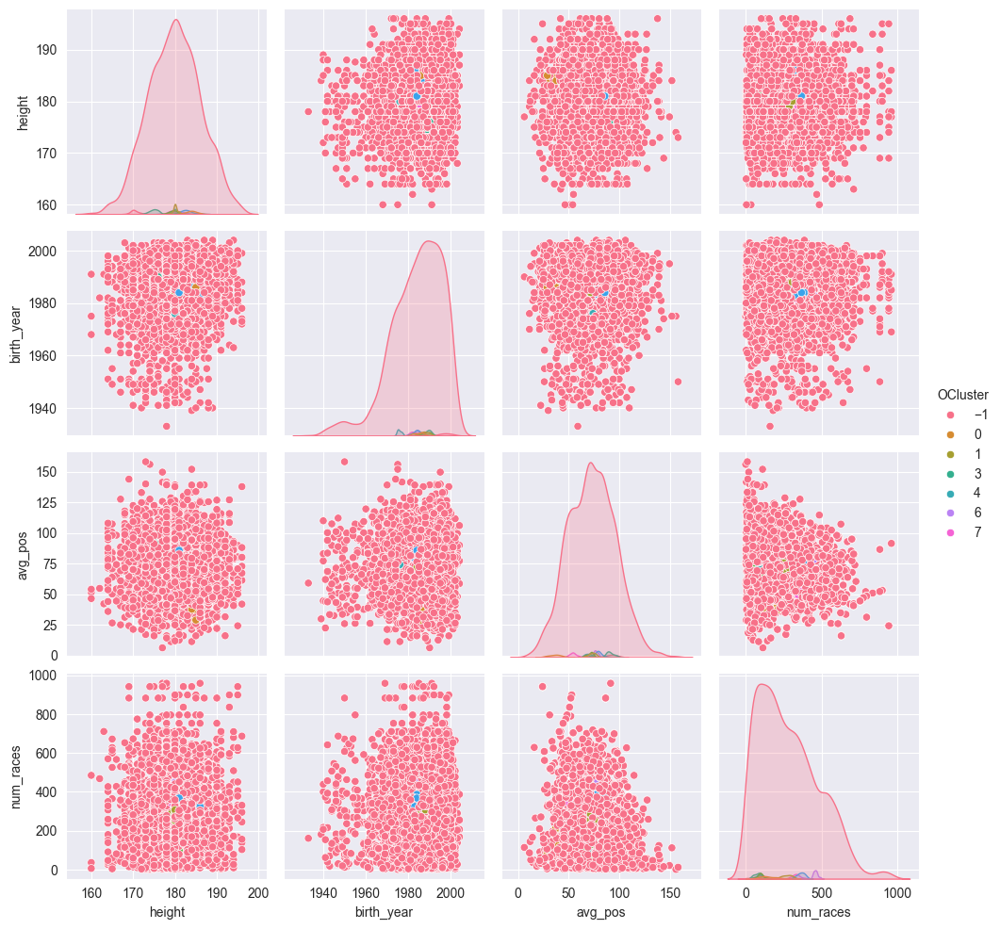

In [65]:
optics = OPTICS(max_eps=0.5, min_samples=2*real_cyclists_df.shape[1], metric='euclidean')
optics.fit(real_cyclists_df.values)

labels = optics.labels_
clustering.optimal_pair_plot(cyclists, 'OCluster', labels)

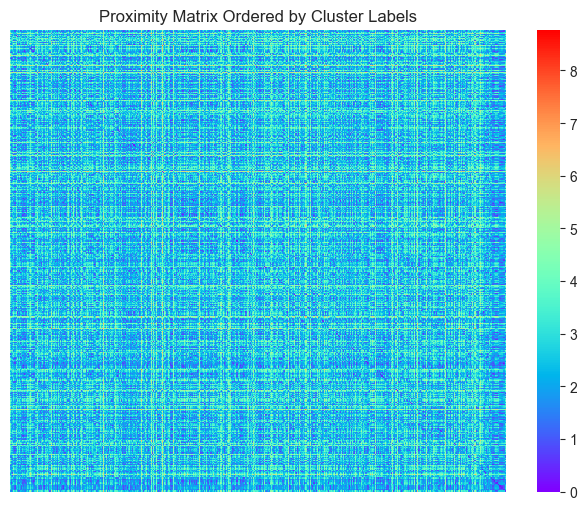

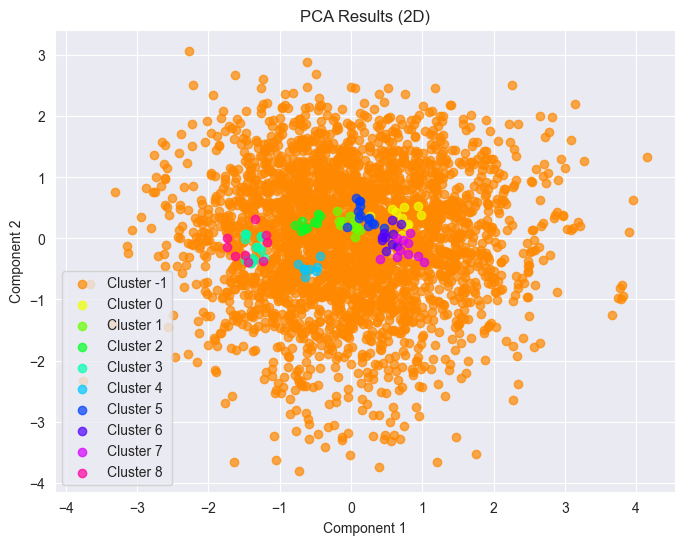

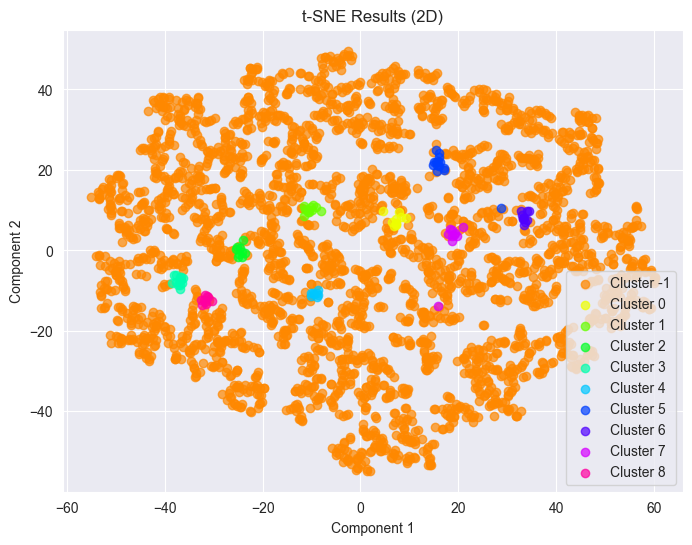

In [66]:
data_scaled = real_cyclists_df

clustering.similarity_matrix(real_cyclists_df, labels)
# 2D PCA
pca_2d = apply_pca(data_scaled, dimensions=2)
plot_results(pca_2d, labels, title="PCA Results (2D)", dimensions=2)

# 2D t-SNE
tsne_2d = apply_tsne(data_scaled, dimensions=2)
plot_results(tsne_2d, labels, title="t-SNE Results (2D)", dimensions=2)

### Optics Stages

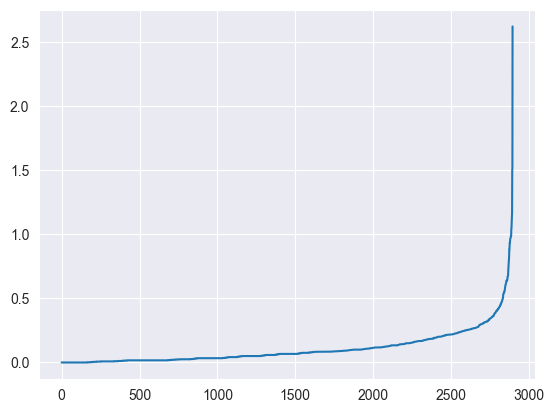

In [67]:
neighbors = NearestNeighbors(n_neighbors=real_stages_df.shape[1]*2)
neighbors_fit = neighbors.fit(real_stages_df)
distances, indices = neighbors_fit.kneighbors(real_stages_df)
distances = np.sort(distances, axis=0)
distances = distances[:,1]
plt.plot(distances)

Results for different eps values:
     eps  Clusters   Noise
0   0.20      12.0  2648.0
1   0.21      13.0  2609.0
2   0.22      16.0  2572.0
3   0.23      17.0  2513.0
4   0.24      18.0  2465.0
5   0.25      19.0  2437.0
6   0.26      22.0  2387.0
7   0.27      24.0  2312.0
8   0.28      27.0  2237.0
9   0.29      27.0  2192.0
10  0.30      27.0  2055.0
11  0.31      30.0  1977.0
12  0.32      29.0  1974.0
13  0.33      31.0  1943.0
14  0.34      31.0  1906.0
15  0.35      33.0  1955.0
16  0.36      35.0  1892.0
17  0.37      37.0  1853.0
18  0.38      36.0  1839.0
19  0.39      37.0  1825.0
20  0.40      39.0  1779.0
21  0.41      41.0  1734.0
22  0.42      40.0  1793.0
23  0.43      42.0  1755.0
24  0.44      41.0  1741.0
25  0.45      41.0  1737.0
26  0.46      41.0  1744.0
27  0.47      41.0  1743.0
28  0.48      41.0  1740.0
29  0.49      42.0  1724.0


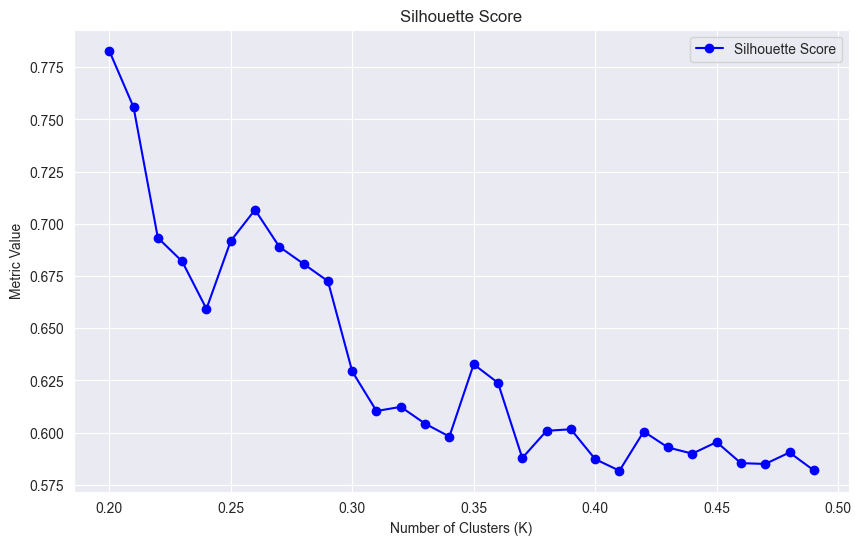

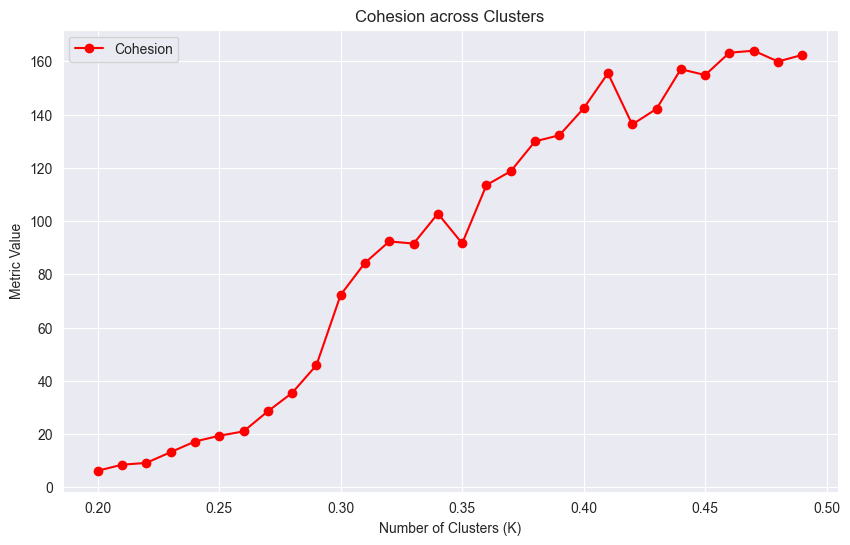

In [68]:
clustering.optics_tune(real_stages_df, np.arange(0.2, 0.5, 0.01))

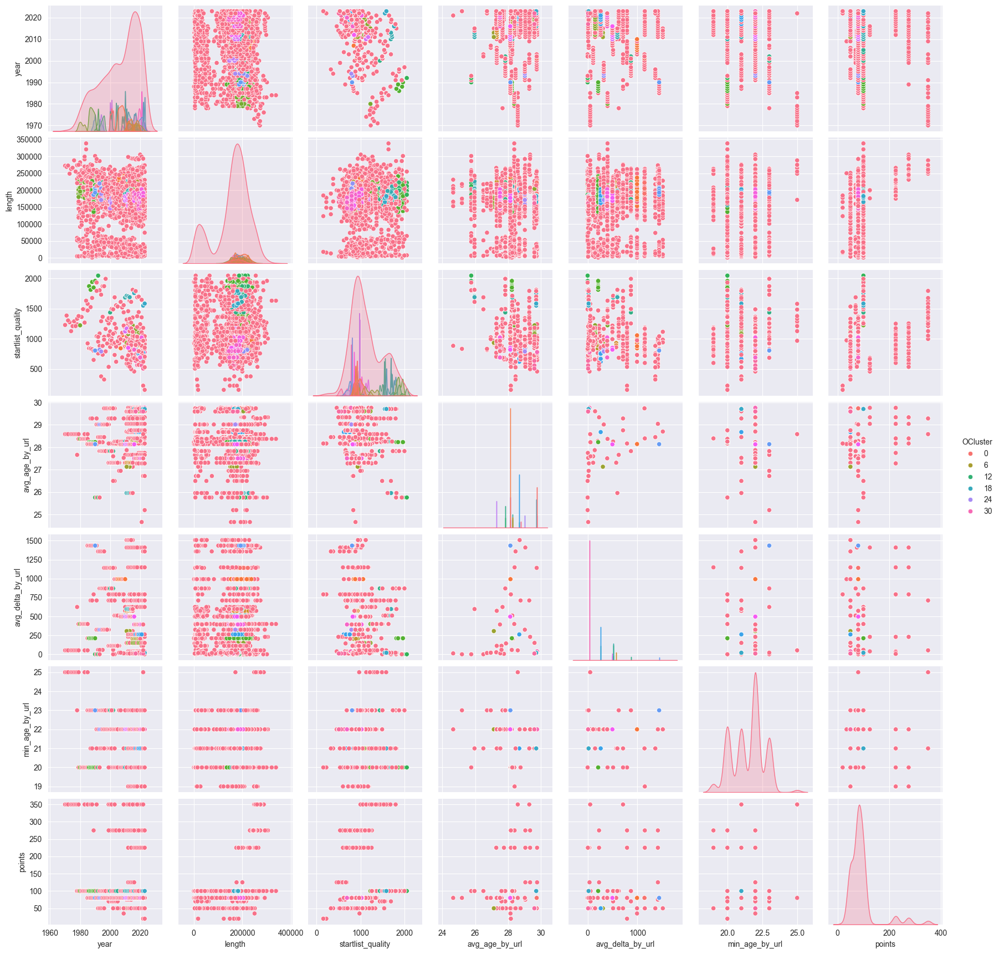

In [69]:
optics = OPTICS(max_eps=0.35, min_samples=2*real_stages_df.shape[1], metric='euclidean')
optics.fit(real_stages_df.values)

labels = optics.labels_
clustering.optimal_pair_plot(stages, 'OCluster', labels)

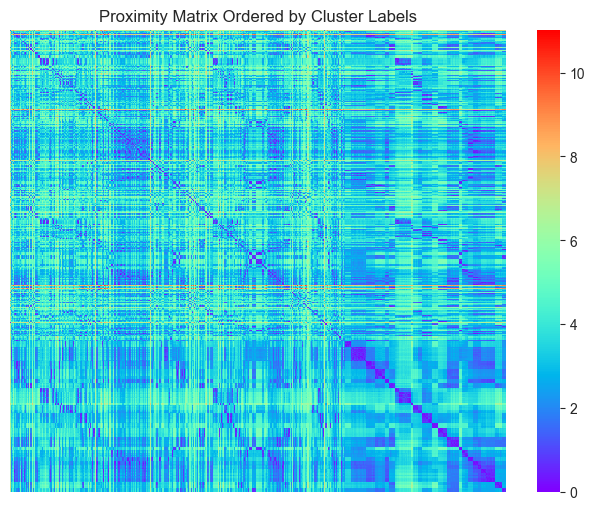

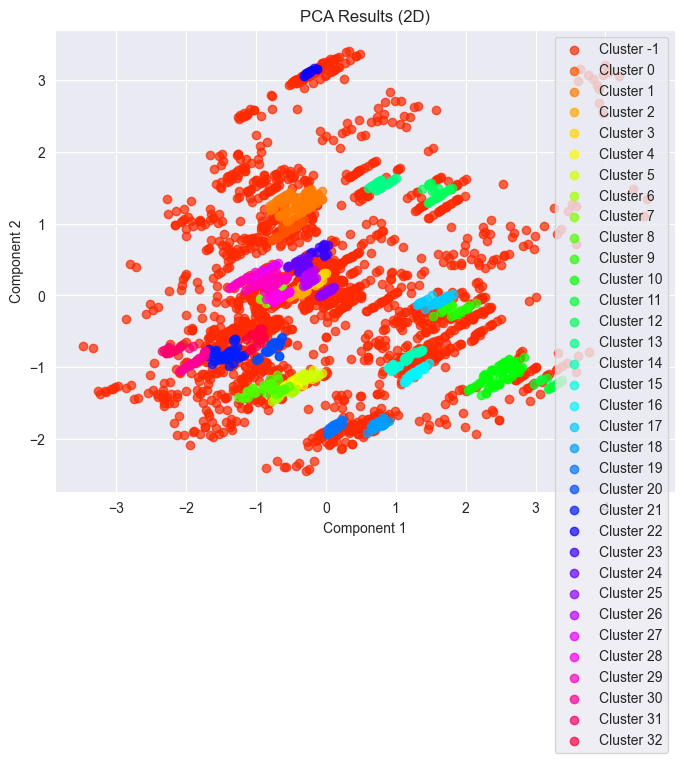

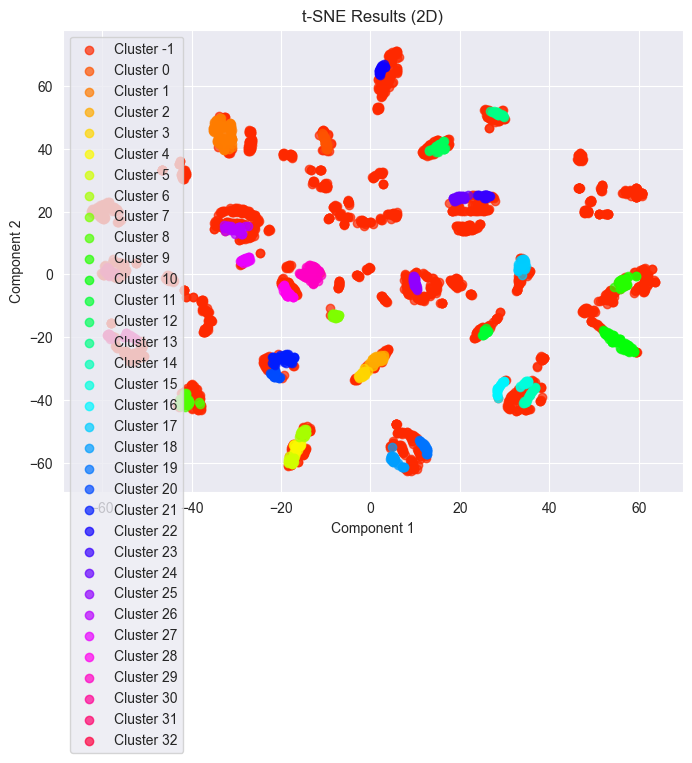

In [70]:
data_scaled = real_stages_df

clustering.similarity_matrix(real_stages_df, labels)
# 2D PCA
pca_2d = apply_pca(data_scaled, dimensions=2)
plot_results(pca_2d, labels, title="PCA Results (2D)", dimensions=2)

# 2D t-SNE
tsne_2d = apply_tsne(data_scaled, dimensions=2)
plot_results(tsne_2d, labels, title="t-SNE Results (2D)", dimensions=2)